
> <div style="background:transparent;
            display:fill;
            color: black;
            font-size: large;">
    <h1 id="overview" style="color:red;"><u><b>OVERVIEW</b></u></h1>
    <a class="anchor-link" href="https://www.kaggle.com/code/gmudit/git-my/notebook#overview">¶</a>
    <p>
            The topic for the wind forecasting track is focused on mimicking the operation 48-hour ahead prediction of hourly power generation at 7 wind farms, based on historical measurements and additional wind forecast information (48-hour ahead predictions of wind speed and direction at the sites). The data is available from the 1st hour of 2009/7/1 to the 12th hour of 2012/6/28.
    </p>
    <p>
            The period between 2009/7/1 and 2010/12/31 is a model identification and training period, while the remainder of the dataset, from 2011/1/1 to 2012/6/28, is there for evaluation. The training period will be used for designing and estimating models permitting predicting wind power generation at lead times from 1 to 48 hours ahead, based on past power observations and/or available meteorological wind forecasts for that period. 
    </p>
    <p>
            The evaluation part, it is aimed at mimicking real operational conditions. For that, a number of 48-hour periods with missing power observations were defined. All these power observations are to be predicted. These periods are defined as follows. 
            The first period with missing observations is from 2011/1/1 at 01:00 until 2011/1/3 at 00:00. 
            The second period with missing observations is from 2011/1/4 at 13:00 until 2011/1/6 at 12:00
   </p>
</div>

> **BASIC IMPORTS**

In [1]:
import warnings
warnings.simplefilter('ignore')

In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

<h1 style="color:red;" id="reading_data"><u><b>READIND DATA AND SOME BASIC PREPROCESSING</b></u></h1>
<a class="anchor-link" href="https://www.kaggle.com/code/gmudit/git-my/notebook#reading_data">¶</a>

In [3]:
train_csv = pd.read_csv("/kaggle/input/GEF2012-wind-forecasting/train.csv")
df = train_csv

FileNotFoundError: [Errno 2] No such file or directory: '/kaggle/input/GEF2012-wind-forecasting/train.csv'

In [ ]:
paths = {f"wp{i}": f"../input/GEF2012-wind-forecasting/windforecasts_wf{i}.csv" for i in range(1, 8)}

> <div style="background:transparent;
            display:fill;
            color: black;
            font-size: large;">
    <h2 style="color:red;" id="data_desc"><b><u>Data Description</u></b></h2>
        <a class="anchor-link" href="https://www.kaggle.com/code/gmudit/git-my/notebook#data_desc">¶</a>
    <a href="https://drive.google.com/file/d/1XjSCeLNWvGNY2L5m78fQ4A4U-PxJN0OK/view?usp=sharing">Link to dataset </a>
    <h3><b>"train.csv" contains the training data:</b></h3>
    <ul>
        <li>the first column ("date") is a timestamp giving the date and time of the hourly wind power measurements in the following columns. For instance "2009070812" is for the 8th of July 2009 at 12:00;
        </li>
        <li>the following 7 columns ("wp1" to "wp7") gather the normalized wind power measurements for the 7 wind farms. They are normalized so as to take values between 0 and 1 in order for the wind farms not to be recognizable.
        </li>
    </ul>
    <p><b>In parallel, files with explanatory variables (wind forecasts) are also provided for those who may want to use them. For example, the file "windforecasts_wf1" contains the wind forecasts for the wind farm 1<br>In these files:</b></p>
    <ul>
        <li>the first column ("date") is a timestamp giving the date and time at which the forecasts are issued. For instance "2009070812" is for the 8th of July 2009 at 12:00;
        </li>
        <li>the second column ("hors") is for the lead time of the forecast. For instance if "date" = 2009070812 and "hors" = 1, the forecast is for the 8th of July 2009 at 13:00
        </li>
        <li>the following 4 columns ("u", "v", "ws" and "wd") are the forecasts themselves, the first two being the zonal and meridional wind components, while the following two are corresponding wind speed and direction.
        </li>
    </ul>
<div>

>**CONVERTING Date COLUMN TO datetime64**
<br>
<a href='https://numpy.org/doc/stable/reference/arrays.datetime.html' style="font-style:None; "><b>        Datetime Documentation Reference Link</b></a>

In [ ]:
df["date"] = pd.to_datetime(df["date"],format = "%Y%m%d%H")
print(df.isnull().sum())
df.head()

date    0
wp1     0
wp2     0
wp3     0
wp4     0
wp5     0
wp6     0
wp7     0
dtype: int64


,date,wp1,wp2,wp3,wp4,wp5,wp6,wp7
0,2009-07-01 00:00:00,0.045,0.233,0.494,0.105,0.056,0.118,0.051
1,2009-07-01 01:00:00,0.085,0.249,0.257,0.105,0.066,0.066,0.051
2,2009-07-01 02:00:00,0.020,0.175,0.178,0.033,0.015,0.026,0.000
3,2009-07-01 03:00:00,0.060,0.085,0.109,0.022,0.010,0.013,0.000
4,2009-07-01 04:00:00,0.045,0.032,0.079,0.039,0.010,0.000,0.000


In [ ]:
def conv_to_datetime(path):
    ws = ["w1","w2","w3","w4","w5","w6","w7"]
    temp = ["temp1","temp2","temp3","temp4","temp5","temp6","temp7"]
    for i in range(1,8):
        ws[i-1] = pd.read_csv(path[f"wp{i}"])
        ws[i-1]["date"] = pd.to_datetime(ws[i-1]["date"],format="%Y%m%d%H")
        ws[i-1]['hors_delta'] = pd.to_timedelta(ws[i-1].hors, unit='hours')
        ws[i-1]['forecast_date'] = ws[i-1]['date']+ ws[i-1]['hors_delta']
        ws[i-1].drop(columns= 'hors_delta', inplace=True)
        ws[i-1]["wind_farm"] = f"wp{i}"
        ws[i-1]["forecast_count"] = ws[i-1].date.map(ws[i-1].groupby("forecast_date").size())
        ws[i-1].dropna(inplace=True)
        temp[i-1] = (ws[i-1].drop(["date", "hors"], axis=1)
.groupby(["forecast_date"], as_index=False)
        .mean()
    )
        temp[i-1].drop("forecast_count",axis=1,inplace=True)
    return temp[0],temp[1],temp[2],temp[3],temp[4],temp[5],temp[6]


In [ ]:
w1,w2,w3,w4,w5,w6,w7 = conv_to_datetime(paths)

In [ ]:
w1.isnull().sum()

forecast_date    0
u                0
v                0
ws               0
wd               0
dtype: int64

In [ ]:
w1["wind_farm"] = "wp1"
w2["wind_farm"] = "wp2"
w3["wind_farm"] = "wp3"
w4["wind_farm"] = "wp4"
w5["wind_farm"] = "wp5"
w6["wind_farm"] = "wp6"
w7["wind_farm"] = "wp7"

> **ROLLING AVERAGES**

In [ ]:
def rolling_averages(data_frame,features):
    for i in range(len(features)):
        data_frame[str(features[i])+"_avg"] = data_frame[str(features[i])].rolling(2).mean()  
        data_frame.loc[0,"u_avg"] =data_frame.loc[0,"u"]
        data_frame.loc[0,"v_avg"] =data_frame.loc[0,"v"]
        data_frame.loc[0,"ws_avg"]=data_frame.loc[0,"ws"]
        data_frame.loc[0,"wd_avg"]=data_frame.loc[0,"wd"]  
    return data_frame

In [ ]:
features = ["u","v","ws","wd"]
w1 = rolling_averages(w1,features)
w2 = rolling_averages(w2,features)
w3 = rolling_averages(w3,features)
w4 = rolling_averages(w4,features)
w5 = rolling_averages(w5,features)
w6 = rolling_averages(w6,features)
w7 = rolling_averages(w7,features)

> **GETTING INDIVIDUAL DATE FEATURES LIKE year, month, day etc.**

In [ ]:
def indiv_date(data_frame):
    data_frame["date"] = pd.to_datetime(data_frame.forecast_date)
    data_frame["year"] = data_frame["date"].dt.year
    data_frame["month"] = data_frame["date"].dt.month
    data_frame["day"] = data_frame["date"].dt.day
    data_frame["hour"] = data_frame["date"].dt.hour
    data_frame["dayofweek"] = data_frame.date.dt.dayofweek
    data_frame['weekday'] = np.where(data_frame.date.dt.dayofweek>4,0,1)
    return data_frame

In [ ]:
w1 = indiv_date(w1)
w2 = indiv_date(w2)
w3 = indiv_date(w3)
w4 = indiv_date(w4)
w5 = indiv_date(w5)
w6 = indiv_date(w6)
w7 = indiv_date(w7)

>**CYCLIC ENCODING**
<br>
Basically in simple terms 
    Cyclic Encoded values are sines and cosines of (`2*pi*Value/MaxValue`)<br>
    `val_sin = np.sin(2 * np.pi * val/max_val)`
    <br>
    `val_cos = np.cos(2 * np.pi *val/max_val)`

In [ ]:
def cyc_encode(data_frame, col, max_val):
    for i in range(len(col)):
        data_frame[col[i] + '_sin'] = np.sin(2 * np.pi * data_frame[col[i]]/max_val[i])
        data_frame[col[i] + '_cos'] = np.cos(2 * np.pi * data_frame[col[i]]/max_val[i])

In [ ]:
col = ["wd_avg","month","day","hour"]
max_val = [360,12,30,24]
cyc_encode(w1, col, max_val)
cyc_encode(w2, col, max_val)
cyc_encode(w3, col, max_val)
cyc_encode(w4, col, max_val)
cyc_encode(w5, col, max_val)
cyc_encode(w6, col, max_val)
cyc_encode(w7, col, max_val)


In [ ]:
temp1 = pd.DataFrame(df[["date","wp1"]])
df1 = pd.merge(temp1,w1,how="left",on="date")
    
temp2 = pd.DataFrame(df[["date","wp2"]])
df2 = pd.merge(temp2,w2,how="left",on="date")

temp3 = pd.DataFrame(df[["date","wp3"]])
df3 = pd.merge(temp3,w3,how="left",on="date")

temp4 = pd.DataFrame(df[["date","wp4"]])
df4 = pd.merge(temp4,w4,how="left",on="date")

temp5 = pd.DataFrame(df[["date","wp5"]])
df5 = pd.merge(temp5,w5,how="left",on="date")

temp6 = pd.DataFrame(df[["date","wp6"]])
df6 = pd.merge(temp6,w6,how="left",on="date")

temp7 = pd.DataFrame(df[["date","wp7"]])
df7 = pd.merge(temp7,w7,how="left",on="date")

In [ ]:
df1.dropna(inplace=True)
df2.dropna(inplace=True)
df3.dropna(inplace=True)
df4.dropna(inplace=True)
df5.dropna(inplace=True)
df6.dropna(inplace=True)
df7.dropna(inplace=True)

In [ ]:
df1.date.is_unique

True

In [ ]:
df1.head()


,date,wp1,forecast_date,u,v,ws,wd,wind_farm,u_avg,v_avg,...,dayofweek,weekday,wd_avg_sin,wd_avg_cos,month_sin,month_cos,day_sin,day_cos,hour_sin,hour_cos
13,2009-07-01 13:00:00,0.00,2009-07-01 13:00:00,2.77,-0.65,2.85,103.17,wp1,2.770,-0.650,...,2.0,1.0,0.973698,-0.227841,-0.5,-0.866025,0.207912,0.978148,-0.258819,-0.965926
14,2009-07-01 14:00:00,0.01,2009-07-01 14:00:00,3.12,-0.74,3.20,103.36,wp1,2.945,-0.695,...,2.0,1.0,0.973319,-0.229455,-0.5,-0.866025,0.207912,0.978148,-0.500000,-0.866025
15,2009-07-01 15:00:00,0.00,2009-07-01 15:00:00,3.29,-0.62,3.35,100.63,wp1,3.205,-0.680,...,2.0,1.0,0.978166,-0.207826,-0.5,-0.866025,0.207912,0.978148,-0.707107,-0.707107
16,2009-07-01 16:00:00,0.00,2009-07-01 16:00:00,3.31,-0.37,3.33,96.42,wp1,3.300,-0.495,...,2.0,1.0,0.988951,-0.148241,-0.5,-0.866025,0.207912,0.978148,-0.866025,-0.500000
17,2009-07-01 17:00:00,0.00,2009-07-01 17:00:00,3.17,-0.13,3.17,92.38,wp1,3.240,-0.250,...,2.0,1.0,0.997053,-0.076719,-0.5,-0.866025,0.207912,0.978148,-0.965926,-0.258819


In [ ]:
df1.drop("forecast_date",axis=1,inplace=True)
df2.drop("forecast_date",axis=1,inplace=True)
df3.drop("forecast_date",axis=1,inplace=True)
df4.drop("forecast_date",axis=1,inplace=True)
df5.drop("forecast_date",axis=1,inplace=True)
df6.drop("forecast_date",axis=1,inplace=True)
df7.drop("forecast_date",axis=1,inplace=True)


> **NOW WE HAVE TO PERFORM EXPLORATORY DATA ANALYSIS ON df1,df2,.....,df7**

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
def plot_corr(df,num):
    plt.figure(figsize=(16, 10))
    sns.heatmap(df.corr(), annot=True, cmap="RdYlGn")
    plt.title(f'FARM{num}')
    
#     sns.heatmap(df.corr(), annot=True, cmap="RdYlGn")
    


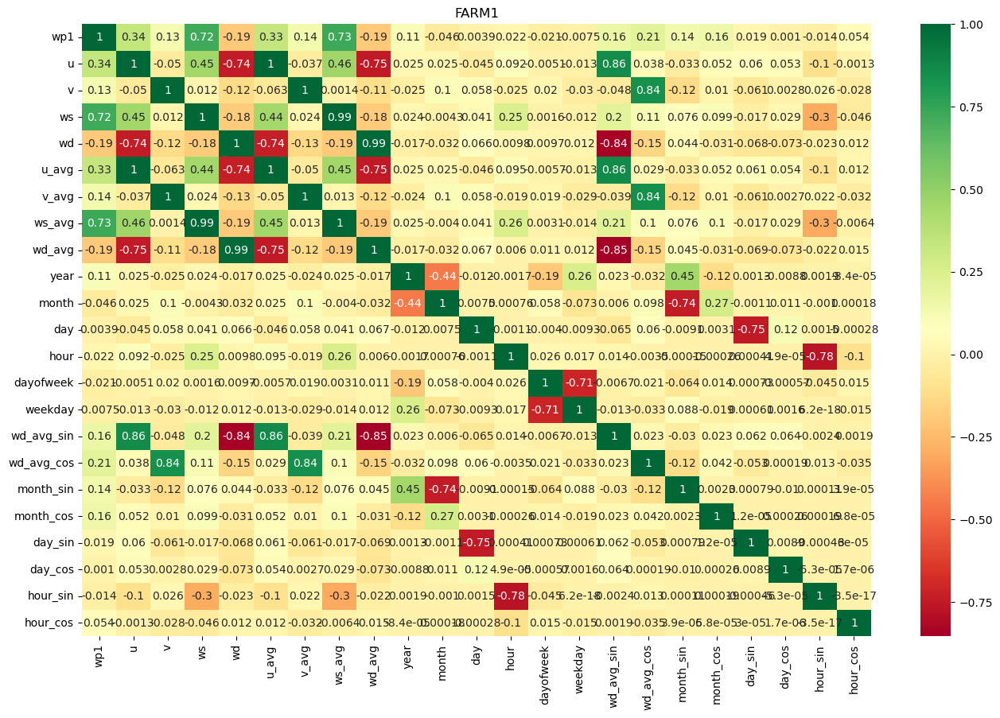

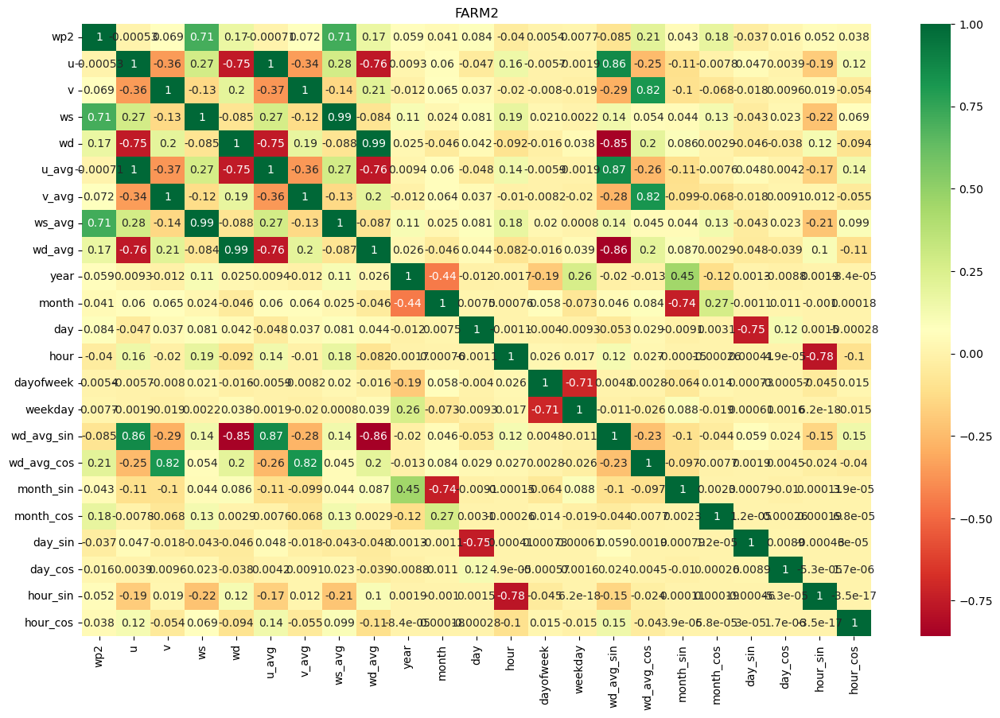

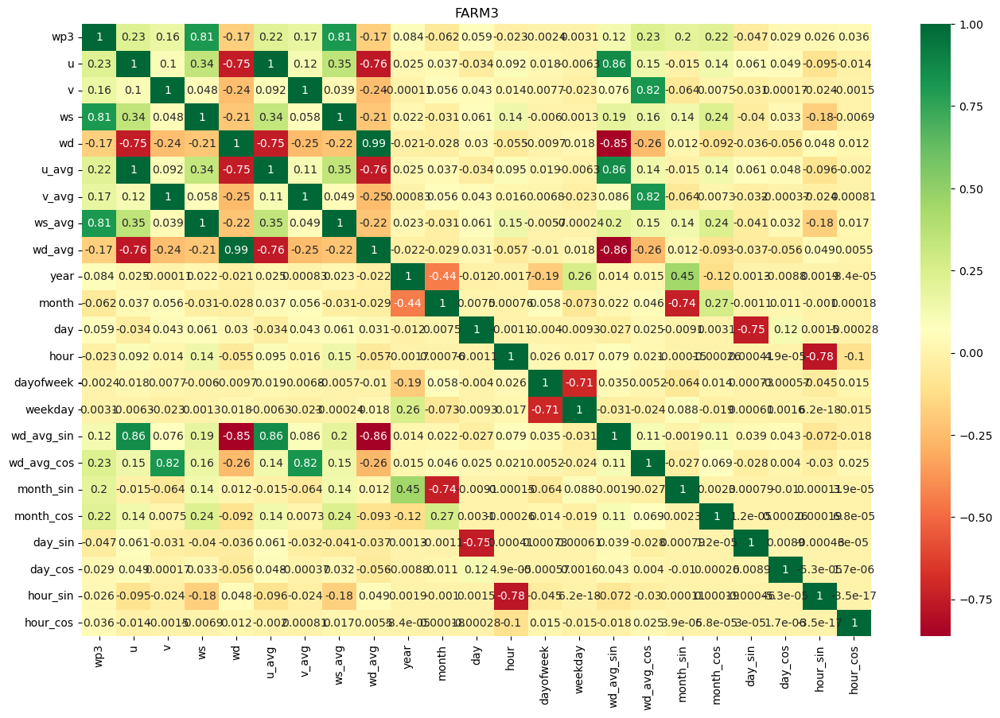

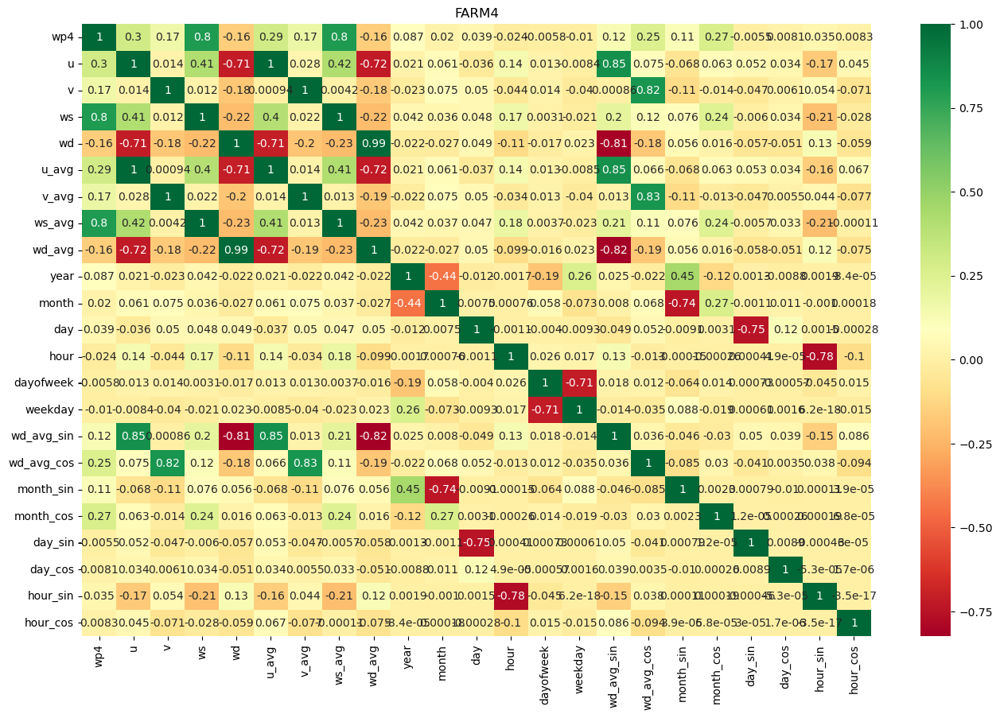

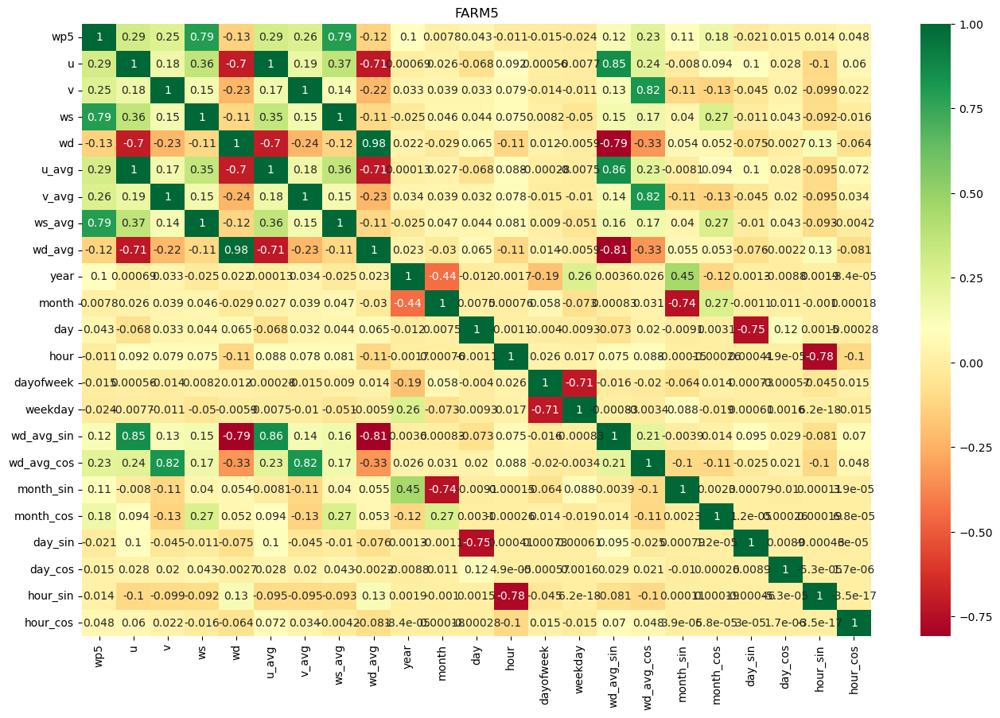

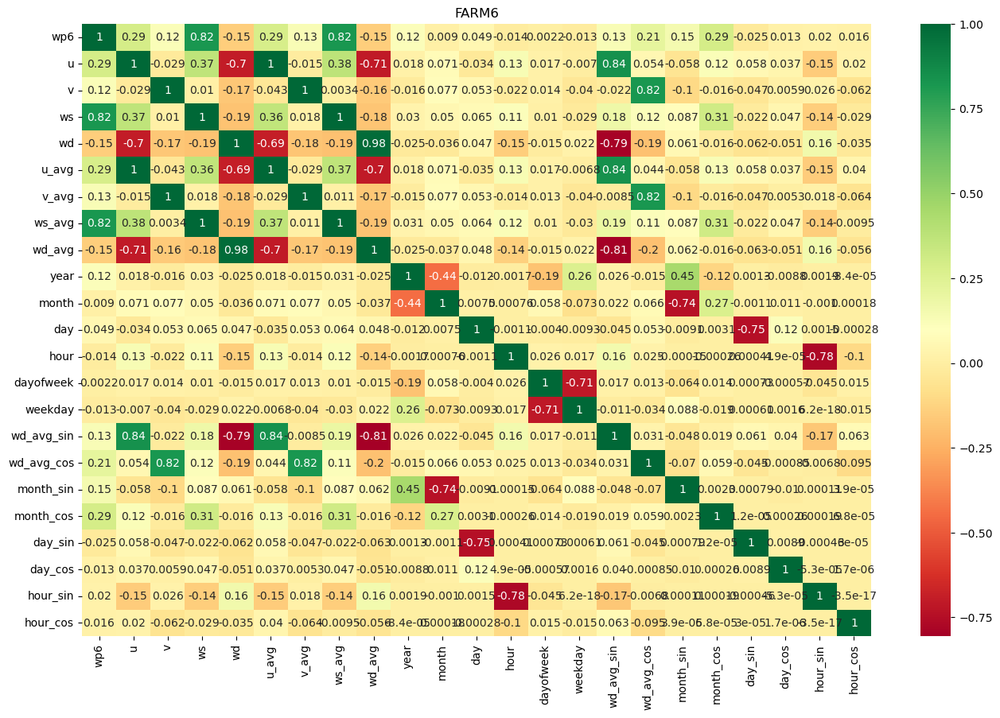

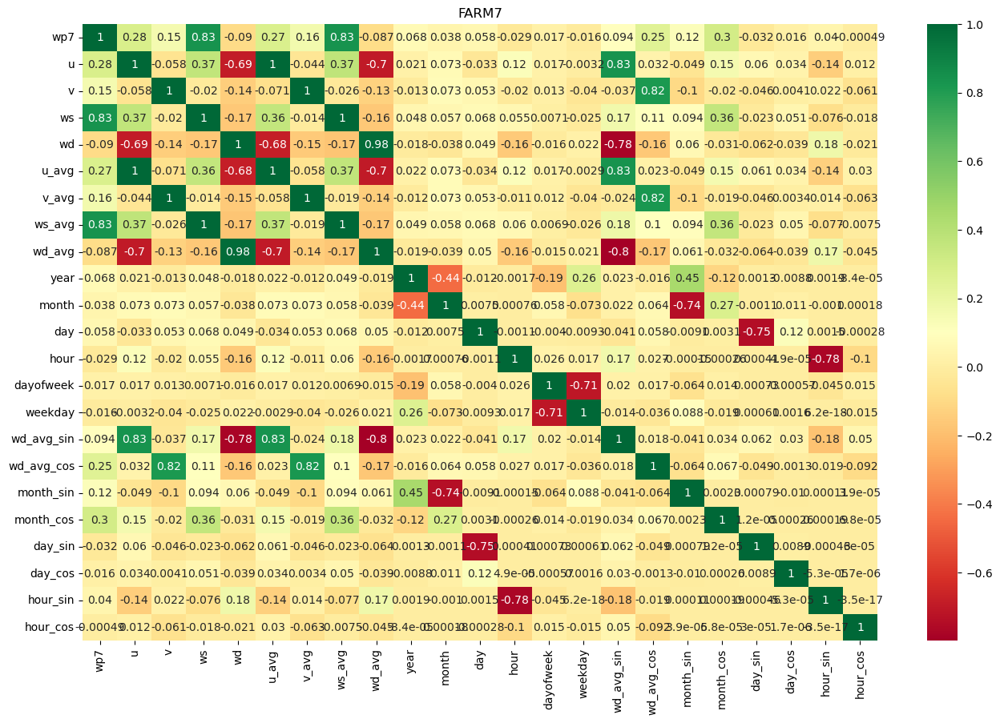

In [ ]:
dfs = [df1,df2,df3,df4,df5,df6,df7]
i=0
for data_frames in dfs:
    i+=1
    plot_corr(data_frames,i)
    

In [ ]:
def plotting_x_vs_y(data_frame,x,y):
    for i in range(len(x)):
        plt.figure(figsize=(20,15))
        plt.scatter(data_frame[x[i]],data_frame[y[0]],c="red",linewidths=2,marker=".")
        plt.xlabel(x[i])
        plt.ylabel("power")
        plt.show()

In [ ]:
X = ['wind_farm', 'u_avg', 'v_avg',
       'ws_avg', 'wd_avg','month', 'day', 'hour', 'dayofweek',
       'weekday', 'wd_avg_sin', 'wd_avg_cos', 'month_sin', 'month_cos',
       'day_sin', 'day_cos', 'hour_sin', 'hour_cos']
Y = ["power"]

In [ ]:
df1["power"] = df1.wp1
df2["power"] = df2.wp2
df3["power"] = df3.wp3
df4["power"] = df4.wp4
df5["power"] = df5.wp5
df6["power"] = df6.wp6
df7["power"] = df7.wp7

> **PLOTTING CORRELATIONS FOR ALL dfs**

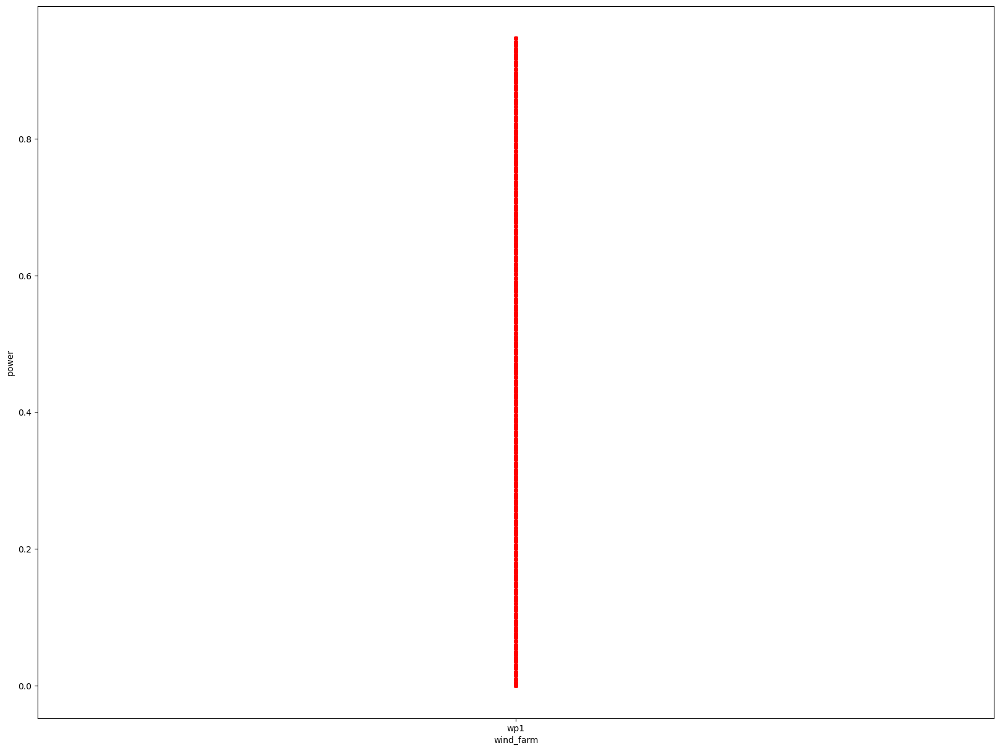

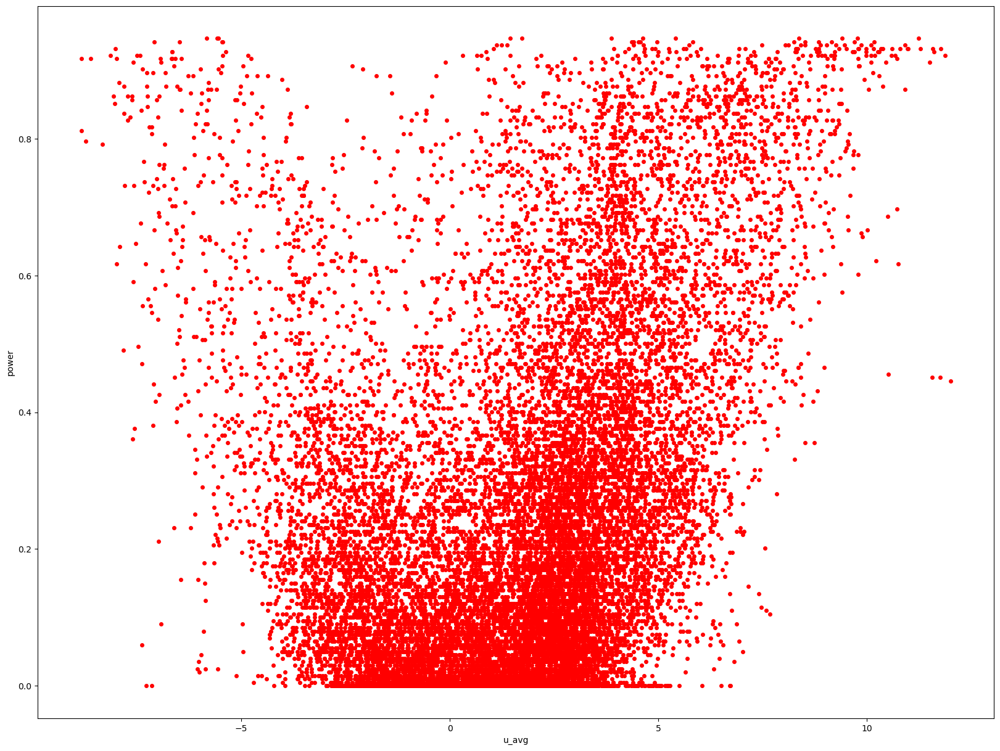

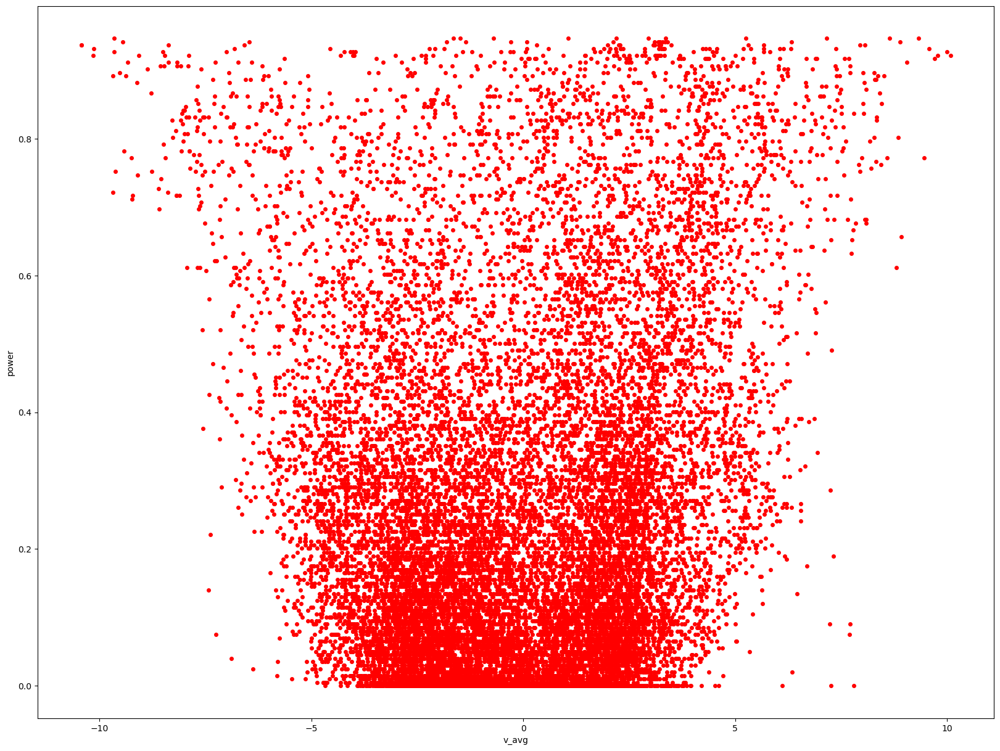

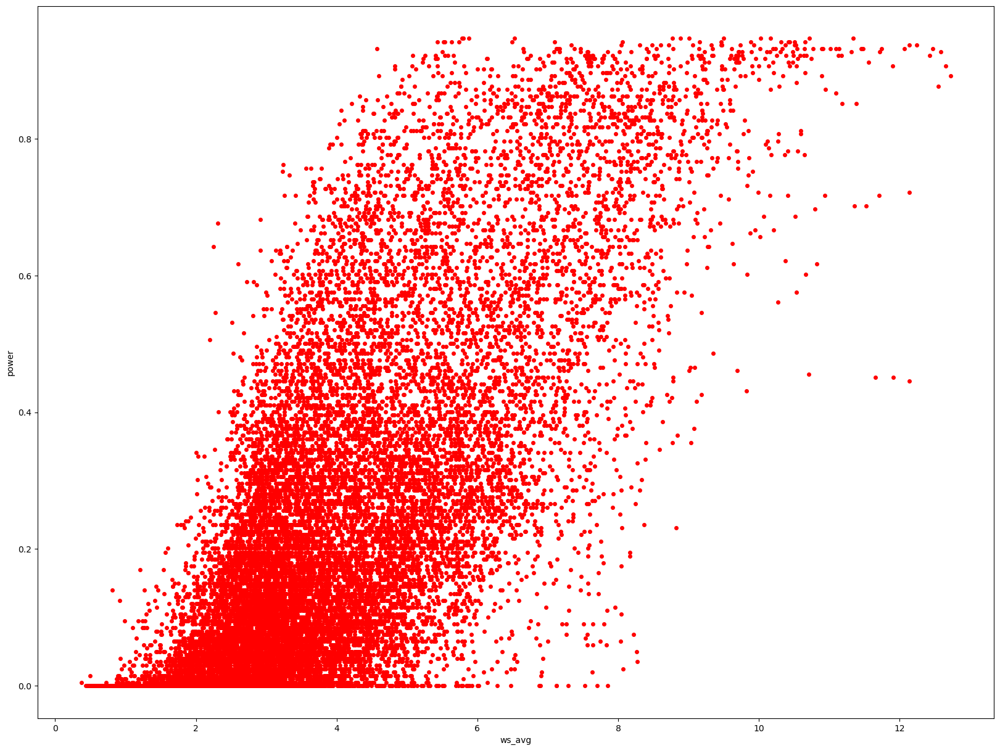

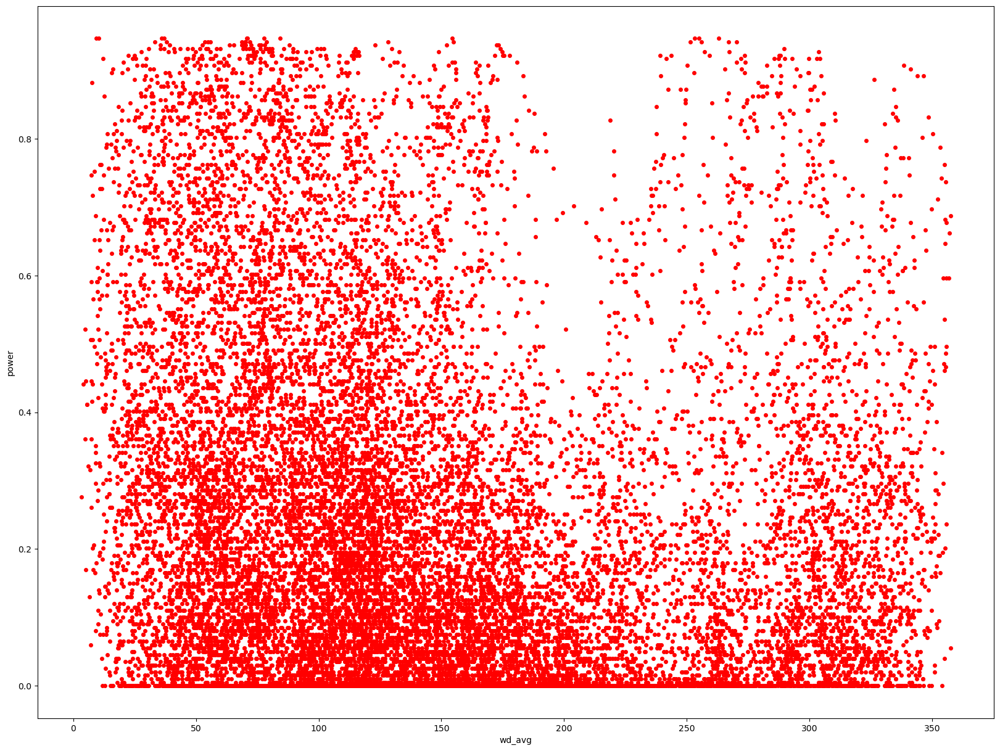

...

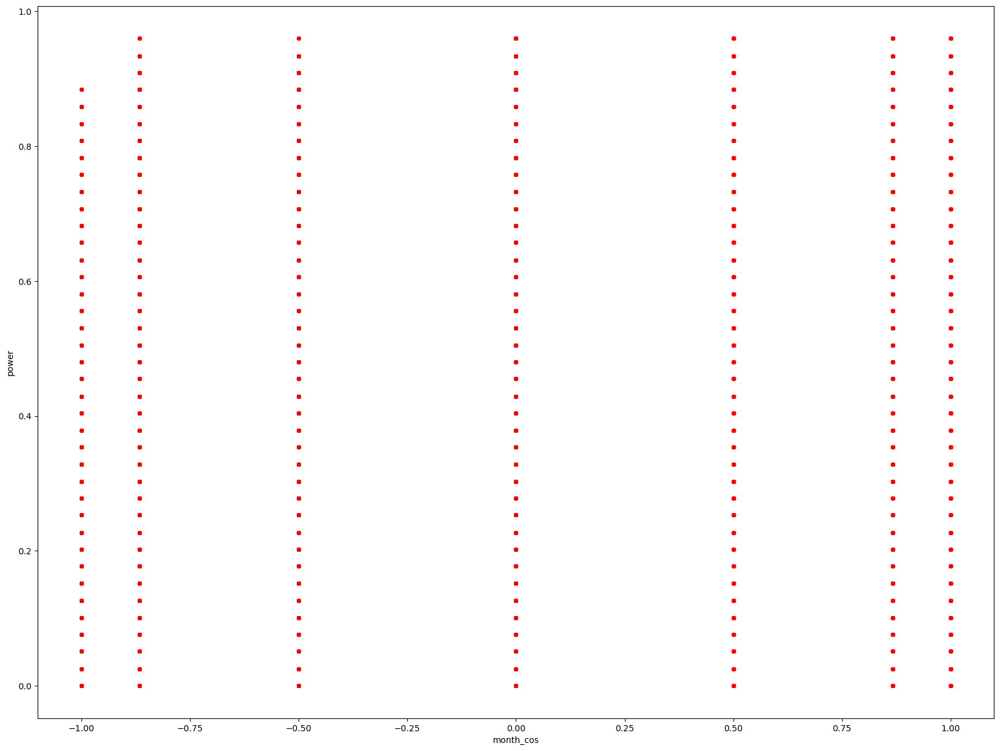

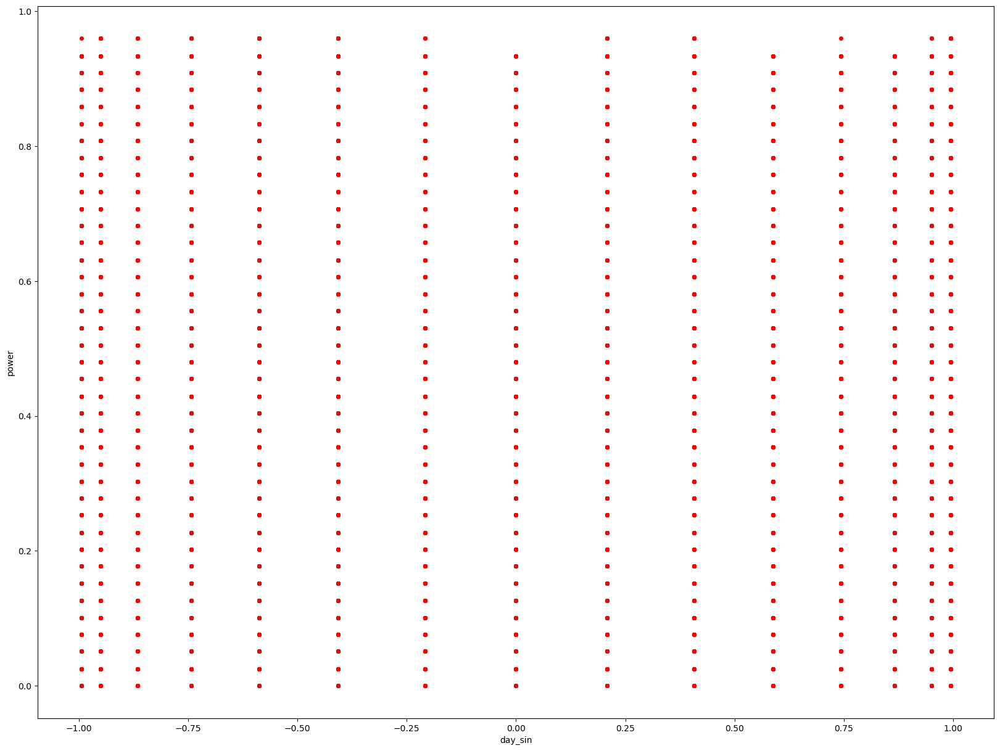

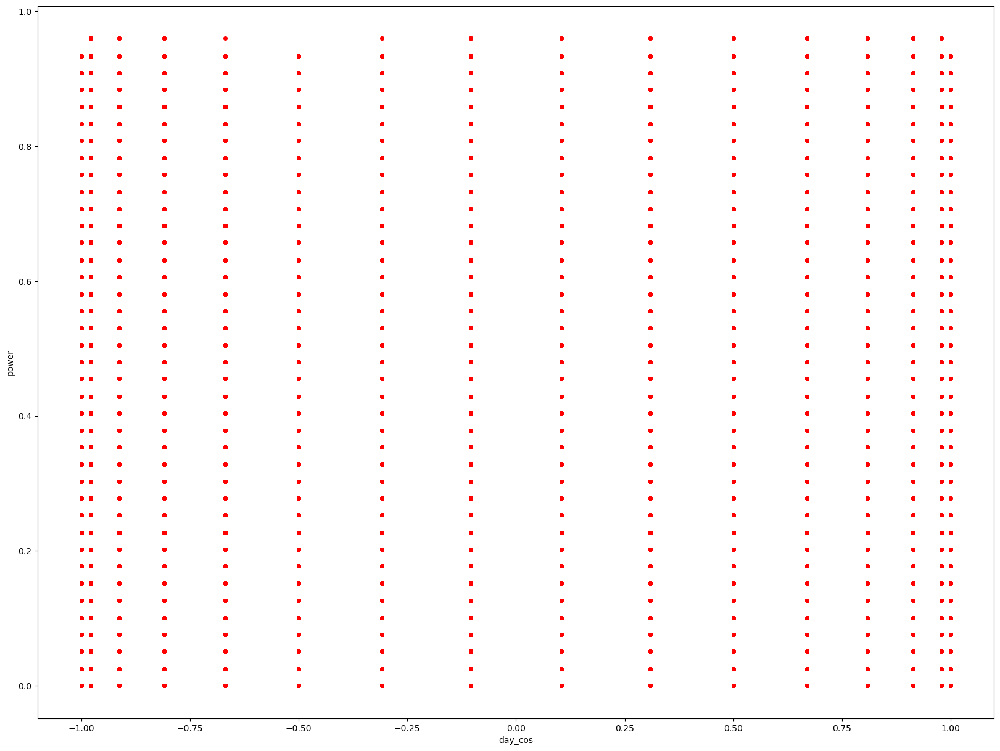

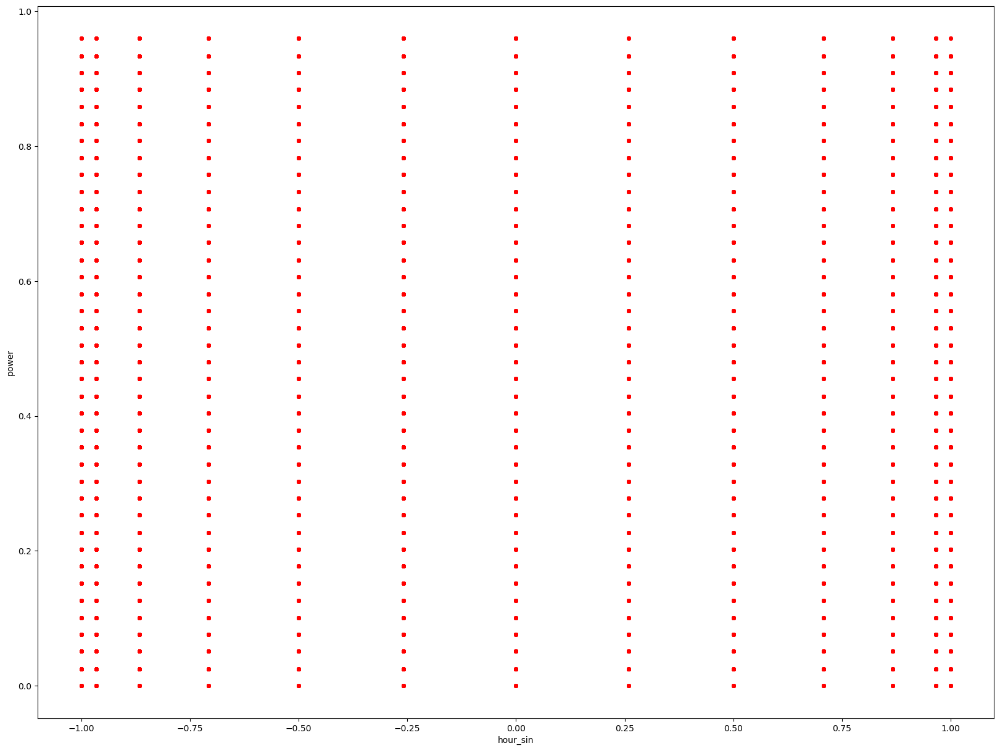

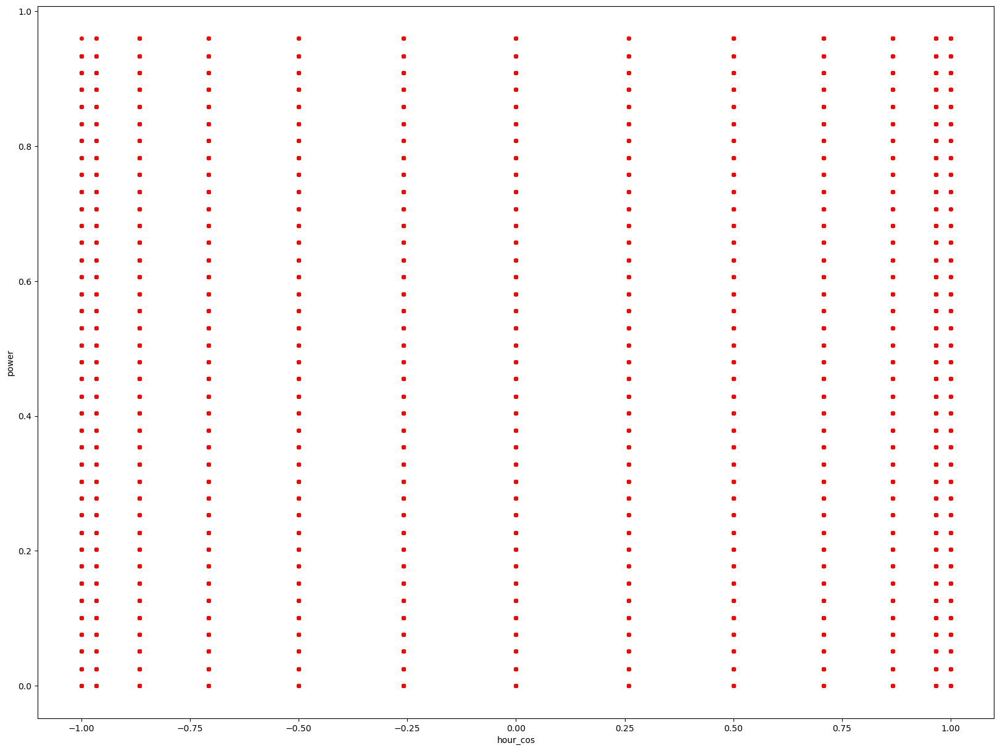

In [ ]:
count = 0
for i in dfs:
    plotting_x_vs_y(i,X,Y)

> **CHECKING RELATIONSHIP BETWEEN ORIGINAL FEATURES**

In [ ]:
a = pd.DataFrame(df1[["wp1","u","v","ws","wd","month","day","hour","dayofweek","weekday"]])
b = pd.DataFrame(df2[["wp2","u","v","ws","wd","month","day","hour","dayofweek","weekday"]])
c = pd.DataFrame(df3[["wp3","u","v","ws","wd","month","day","hour","dayofweek","weekday"]])
d = pd.DataFrame(df4[["wp4","u","v","ws","wd","month","day","hour","dayofweek","weekday"]])
e = pd.DataFrame(df5[["wp5","u","v","ws","wd","month","day","hour","dayofweek","weekday"]])
f = pd.DataFrame(df6[["wp6","u","v","ws","wd","month","day","hour","dayofweek","weekday"]])
g = pd.DataFrame(df7[["wp7","u","v","ws","wd","month","day","hour","dayofweek","weekday"]])

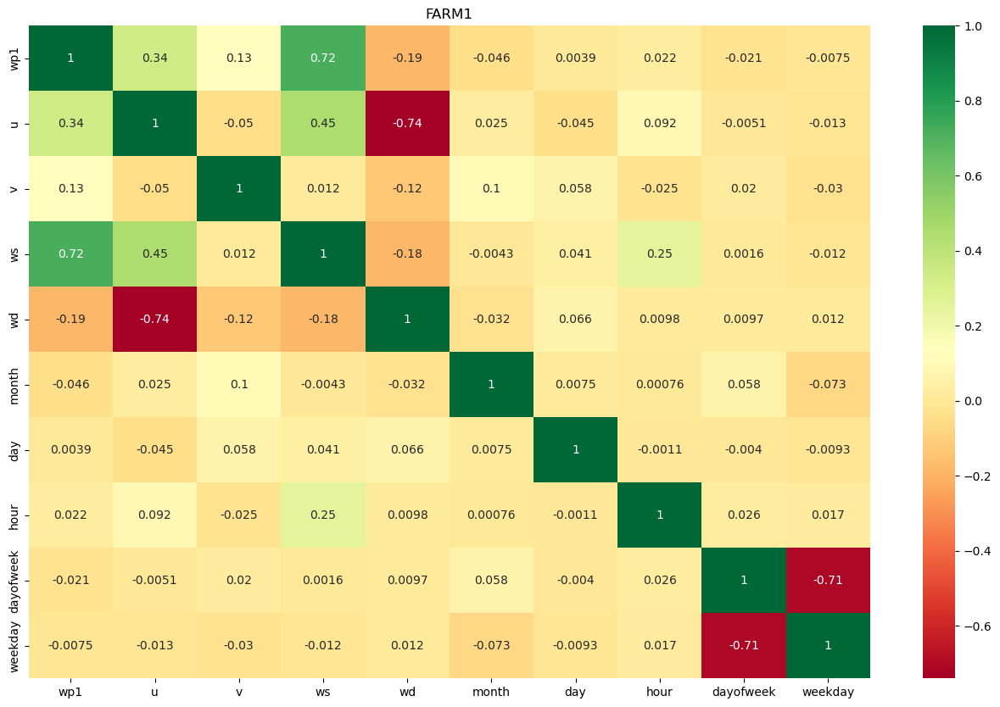

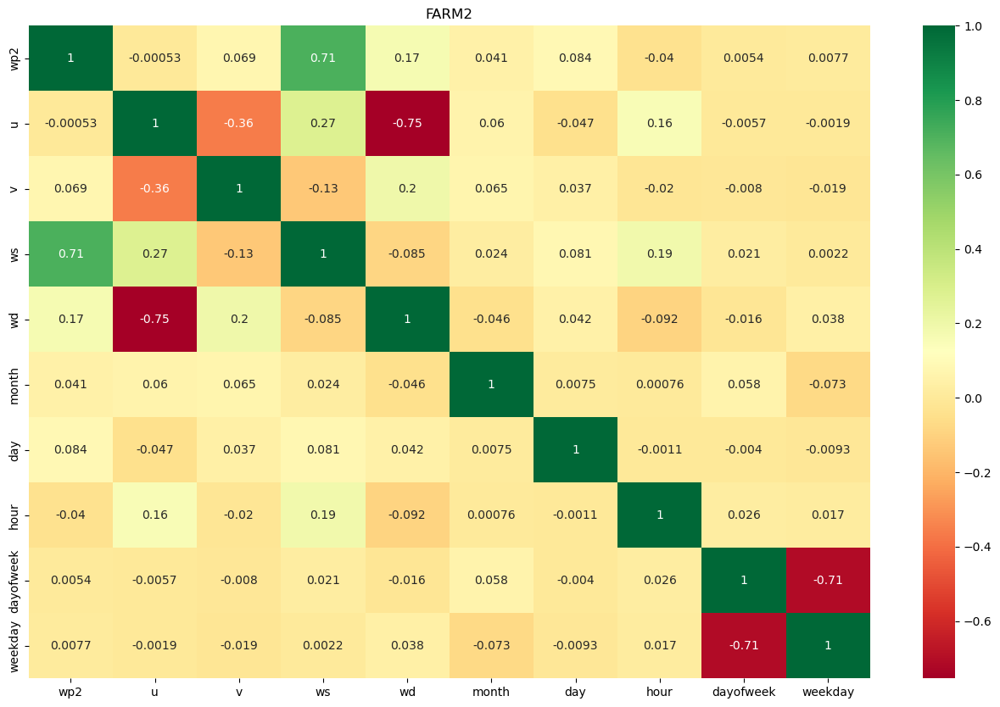

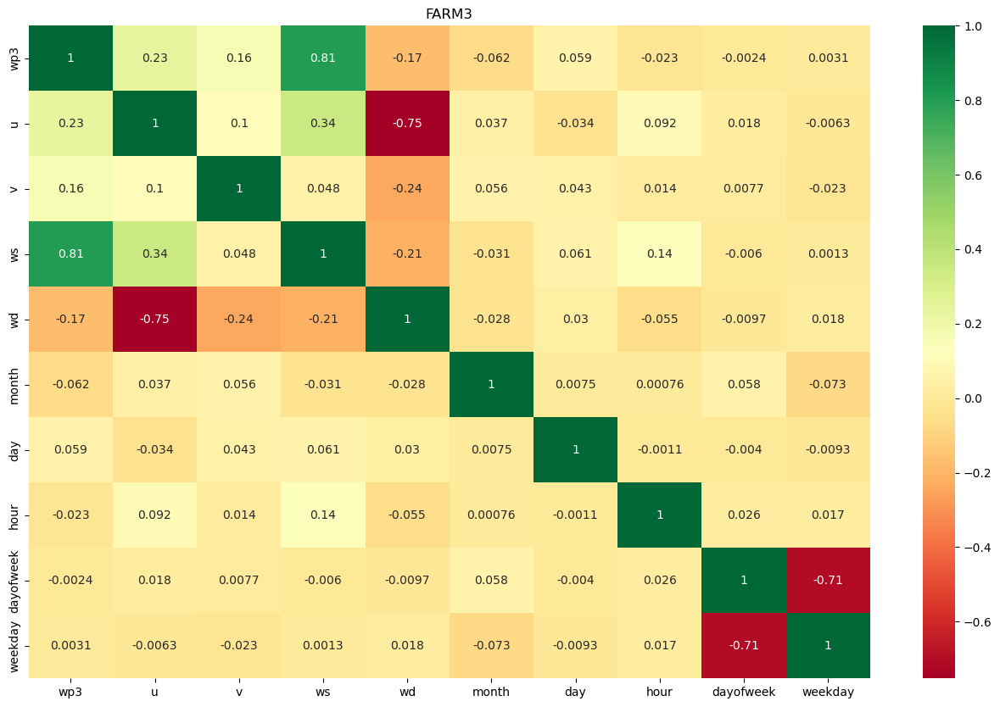

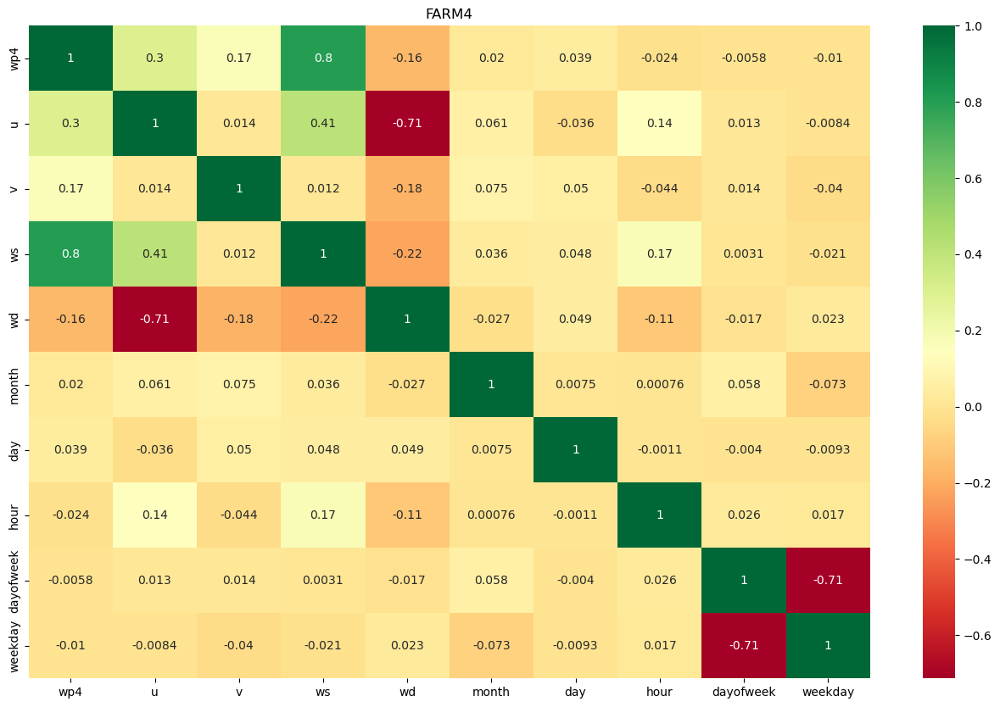

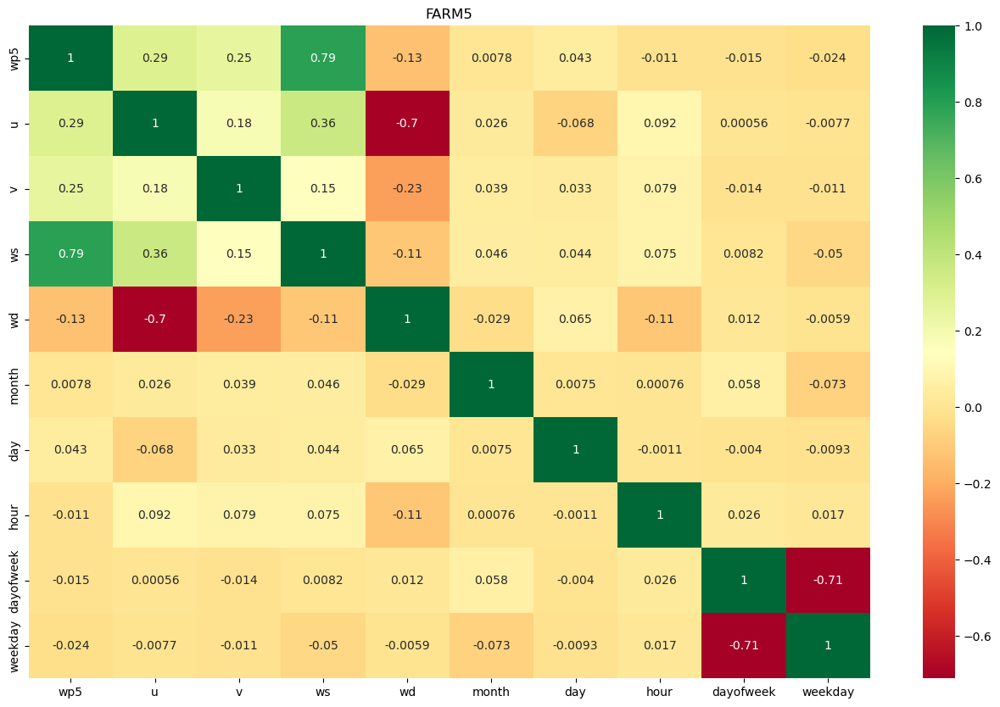

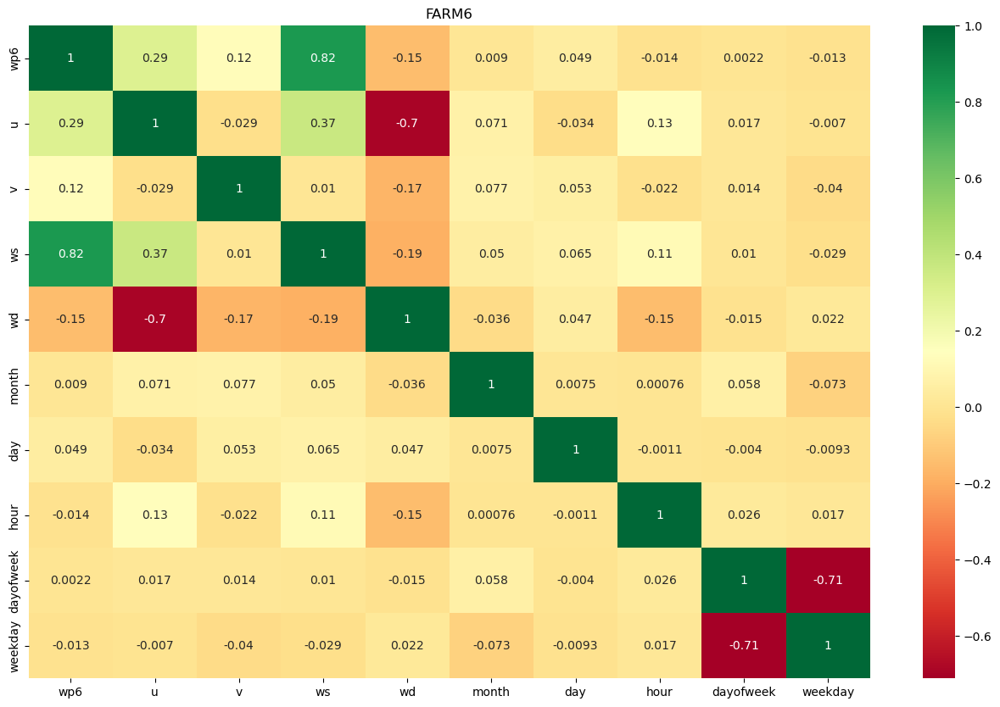

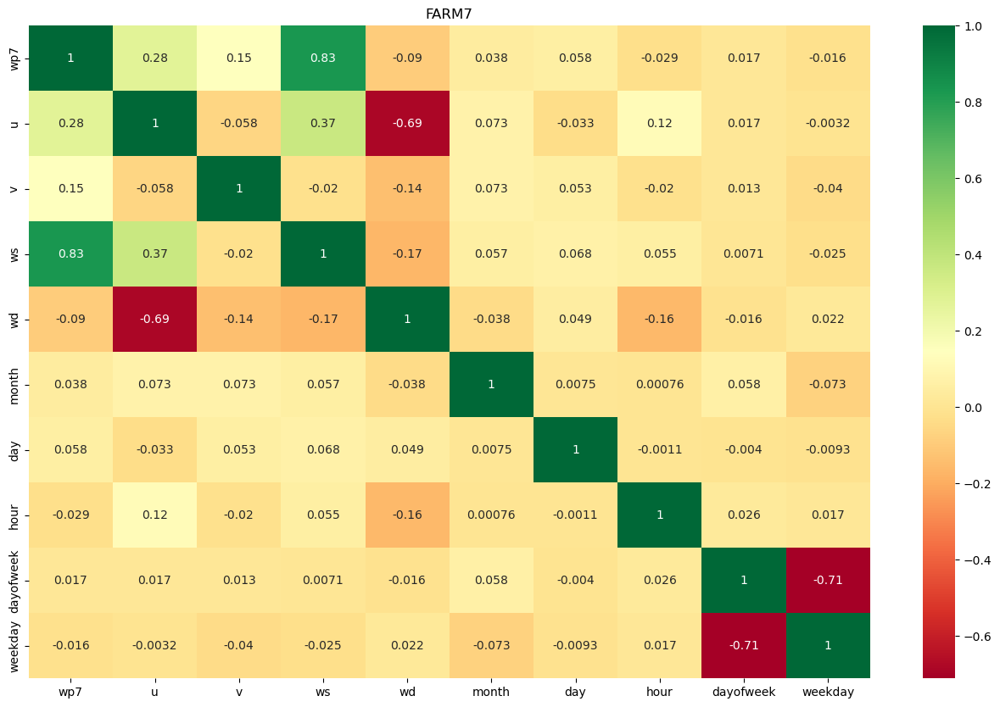

In [ ]:
l = [a,b,c,d,e,f,g]
j=1
for i in l:
    plot_corr(i,j)
    j+=1

In [ ]:
for i in range(len(dfs)):
    l[i]= pd.DataFrame(dfs[i])
    l[i]["power"] = dfs[i][f"wp{i+1}"]
    l[i].drop(f"wp{i+1}",axis=1,inplace=True)
    
combined = pd.concat([l[0],l[1],l[2],l[3],l[4],l[5],l[6]],axis=0)

In [ ]:
combined.head()

,date,u,v,ws,wd,wind_farm,u_avg,v_avg,ws_avg,wd_avg,...,weekday,wd_avg_sin,wd_avg_cos,month_sin,month_cos,day_sin,day_cos,hour_sin,hour_cos,power
13,2009-07-01 13:00:00,2.77,-0.65,2.85,103.17,wp1,2.770,-0.650,2.850,103.170,...,1.0,0.973698,-0.227841,-0.5,-0.866025,0.207912,0.978148,-0.258819,-0.965926,0.00
14,2009-07-01 14:00:00,3.12,-0.74,3.20,103.36,wp1,2.945,-0.695,3.025,103.265,...,1.0,0.973319,-0.229455,-0.5,-0.866025,0.207912,0.978148,-0.500000,-0.866025,0.01
15,2009-07-01 15:00:00,3.29,-0.62,3.35,100.63,wp1,3.205,-0.680,3.275,101.995,...,1.0,0.978166,-0.207826,-0.5,-0.866025,0.207912,0.978148,-0.707107,-0.707107,0.00
16,2009-07-01 16:00:00,3.31,-0.37,3.33,96.42,wp1,3.300,-0.495,3.340,98.525,...,1.0,0.988951,-0.148241,-0.5,-0.866025,0.207912,0.978148,-0.866025,-0.500000,0.00
17,2009-07-01 17:00:00,3.17,-0.13,3.17,92.38,wp1,3.240,-0.250,3.250,94.400,...,1.0,0.997053,-0.076719,-0.5,-0.866025,0.207912,0.978148,-0.965926,-0.258819,0.00


In [ ]:
combined.columns

Index(['date', 'u', 'v', 'ws', 'wd', 'wind_farm', 'u_avg', 'v_avg', 'ws_avg',
       'wd_avg', 'year', 'month', 'day', 'hour', 'dayofweek', 'weekday',
       'wd_avg_sin', 'wd_avg_cos', 'month_sin', 'month_cos', 'day_sin',
       'day_cos', 'hour_sin', 'hour_cos', 'power'],
      dtype='object')

> **REMOVING ORIGINAL FEATURES**

In [ ]:
to_analyze = combined[['date','wind_farm', 'u_avg', 'v_avg', 'ws_avg',
       'wd_avg', 'year', 'month', 'day', 'hour', 'dayofweek', 'weekday',
       'wd_avg_sin', 'wd_avg_cos', 'month_sin', 'month_cos', 'day_sin',
       'day_cos', 'hour_sin', 'hour_cos', 'power']]

<Axes: >

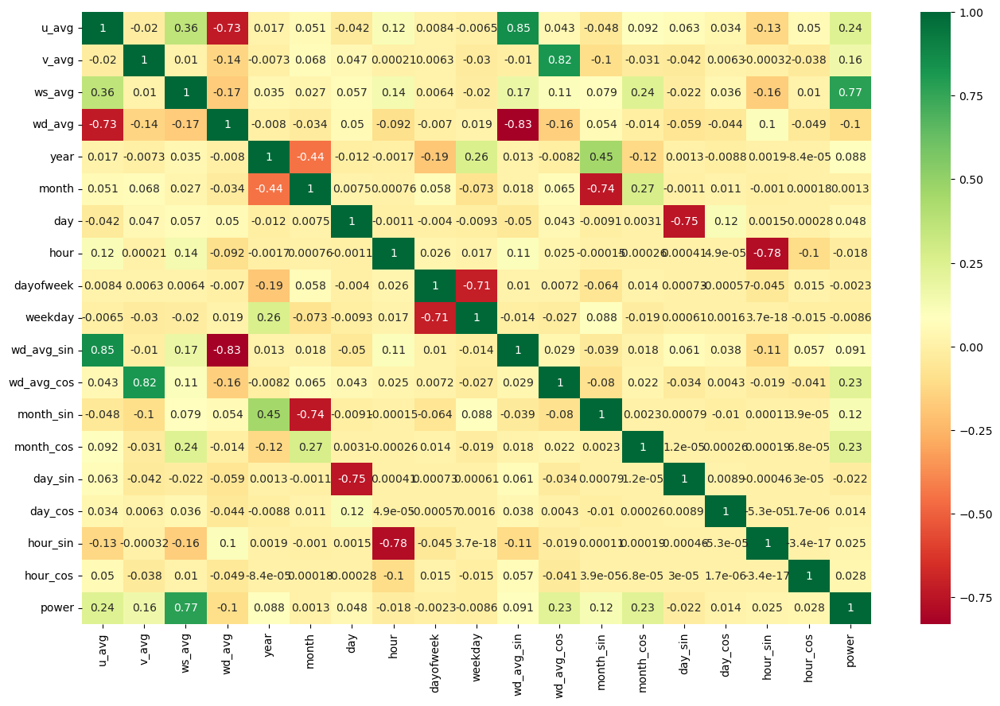

In [ ]:
plt.figure(figsize=(16, 10))
sns.heatmap(to_analyze.corr(), annot=True, cmap="RdYlGn")

In [ ]:
# plot_corr(to_analyze)

> **We can say conclude from above analysis that**
><ul style="list-style:square; color:green; font-weight:bold;">
    <li>Date</li>
    <li>wind_farm</li>
    <li>u_avg</li>
    <li>v_avg</li>
    <li>ws_avg</li>
    <li>wd_avg_sin</li>
    <li>wd_avg_cos</li>
    <li>month_sin</li>
    <li>month_cos</li>
    <li>day_sin</li>
    <li>day_cos</li>
    <li>hour_sin</li>
     <li>hour_cos</li>
 </ul>


ARE IMPORTANT FEATURES

In [ ]:
imp = to_analyze[['date','wind_farm', 'u_avg', 'v_avg', 'ws_avg','wd_avg_sin', 'wd_avg_cos','month_sin', 'month_cos', 'day_sin','day_cos', 'hour_sin', 'hour_cos','power']]

<Axes: >

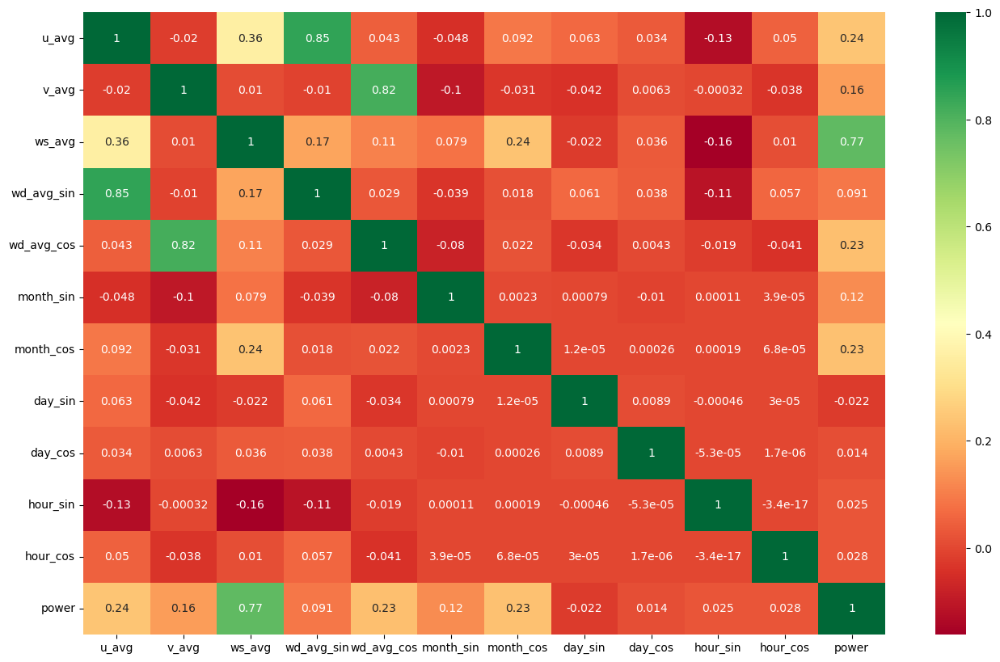

In [ ]:
plt.figure(figsize=(16, 10))
sns.heatmap(imp.corr(), annot=True, cmap="RdYlGn")

In [ ]:
# plot_corr(imp)

> **WE CAN INFER THAT THERE IS A STRONG RELATIONSHIP BETWEEN:**
><ul style="list-style:square; color:green; font-weight:bold;">
    <li style="list-style=square; color:green; font-weight:bold;">wd_avg_sin and u_avg</li>
    <li style="list-style=square; color:green; font-weight:bold;">wd_avg_cos and v_avg</li>
    <li style="list-style=square; color:green; font-weight:bold;">power and ws_avg</li>
 </ul>

In [ ]:
def plotting_x_vs_y(data_frame,x,y):
    for i in range(len(x)):
        plt.figure(figsize=(20,15))
        plt.scatter(data_frame[x[i]],data_frame[y[0]],c="red",linewidths=2,marker=".")
        plt.xlabel(x[i])
        plt.ylabel(y[0])
        plt.show()



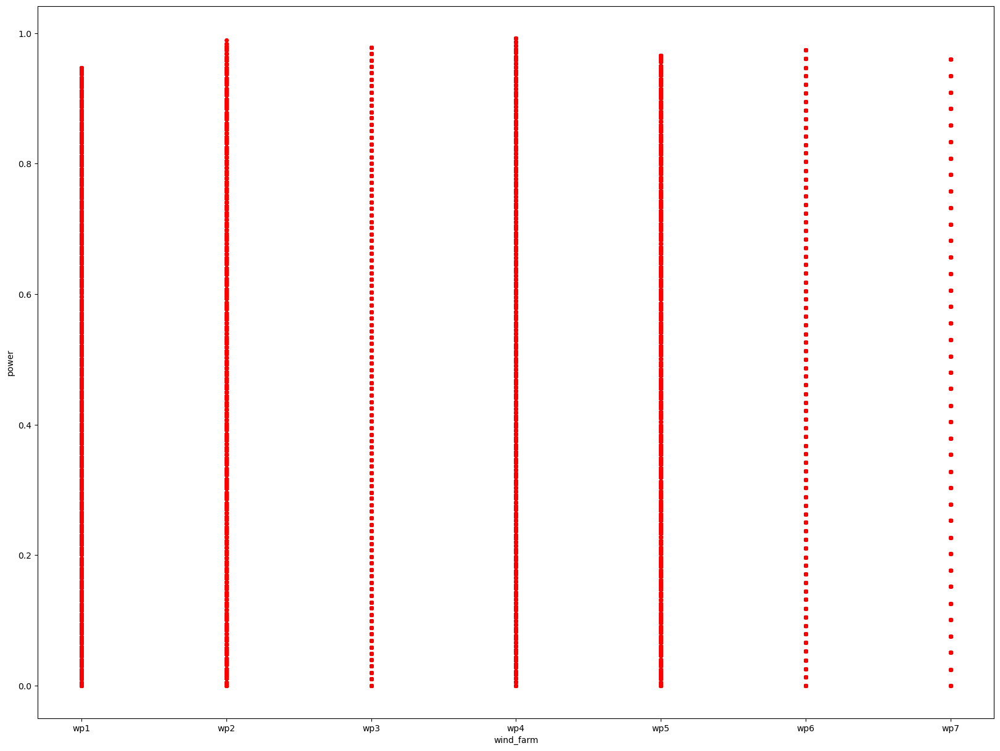

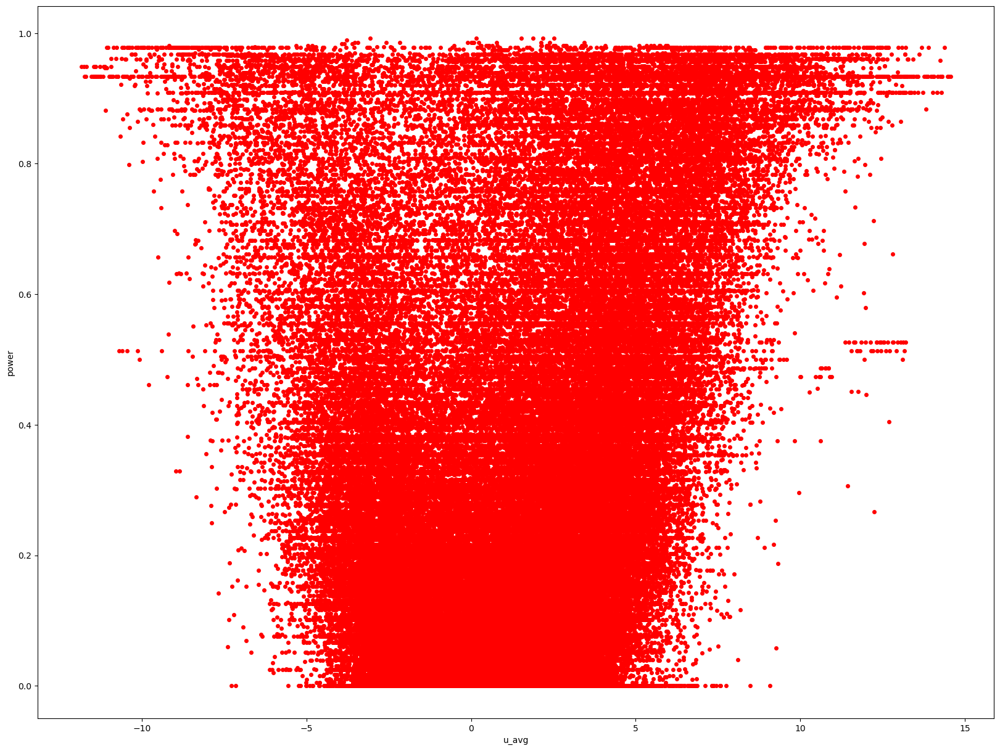

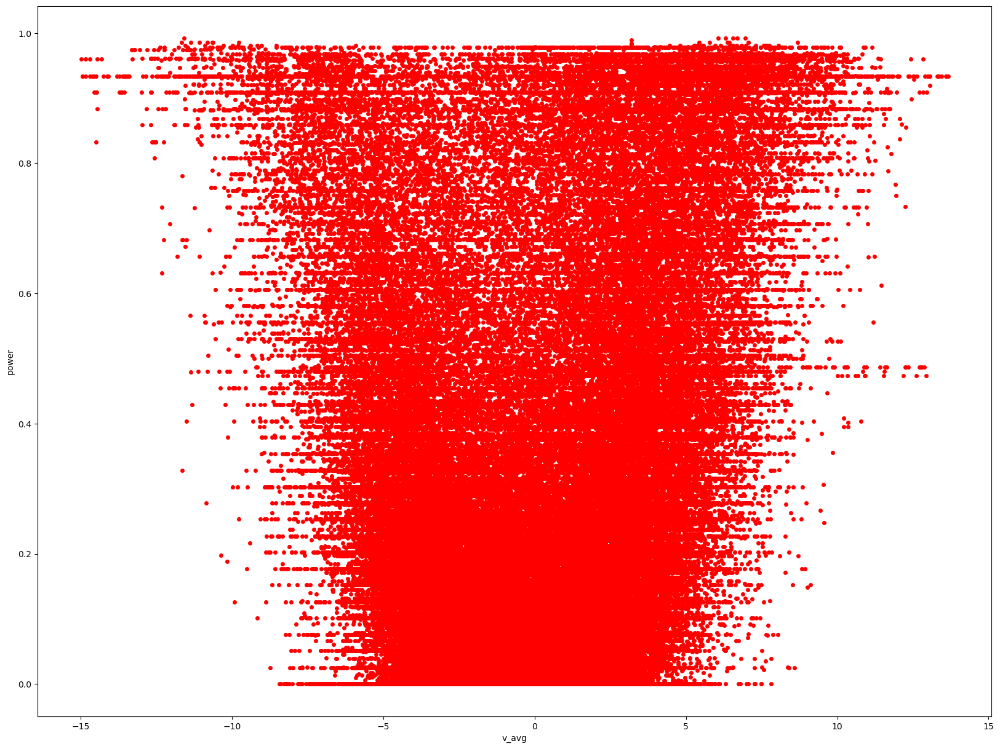

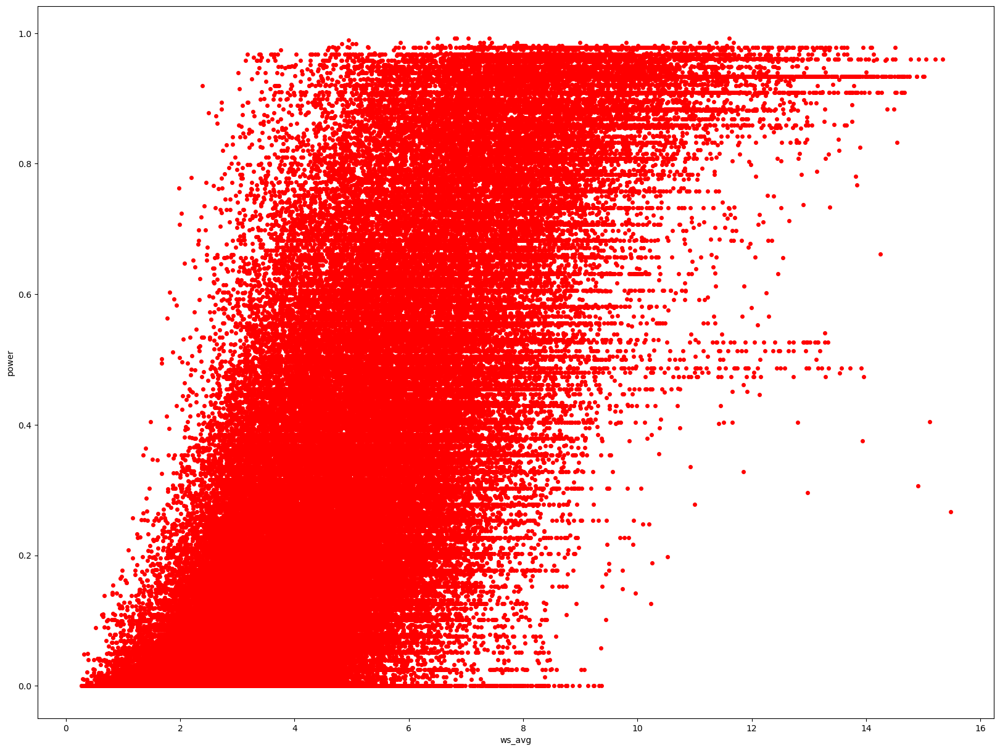

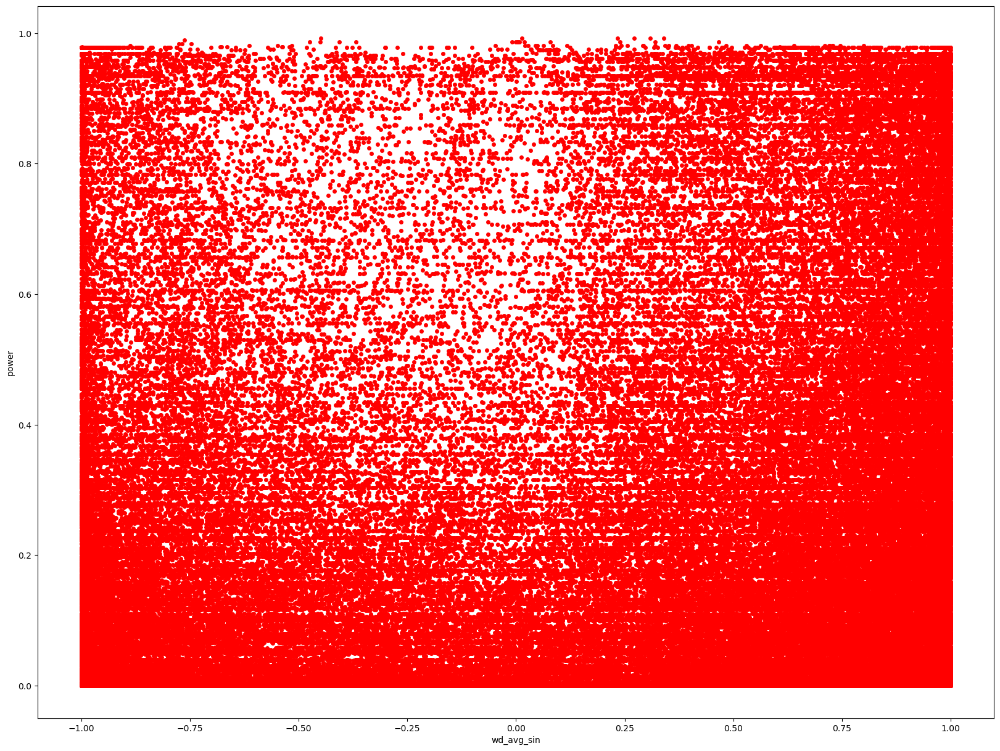

...

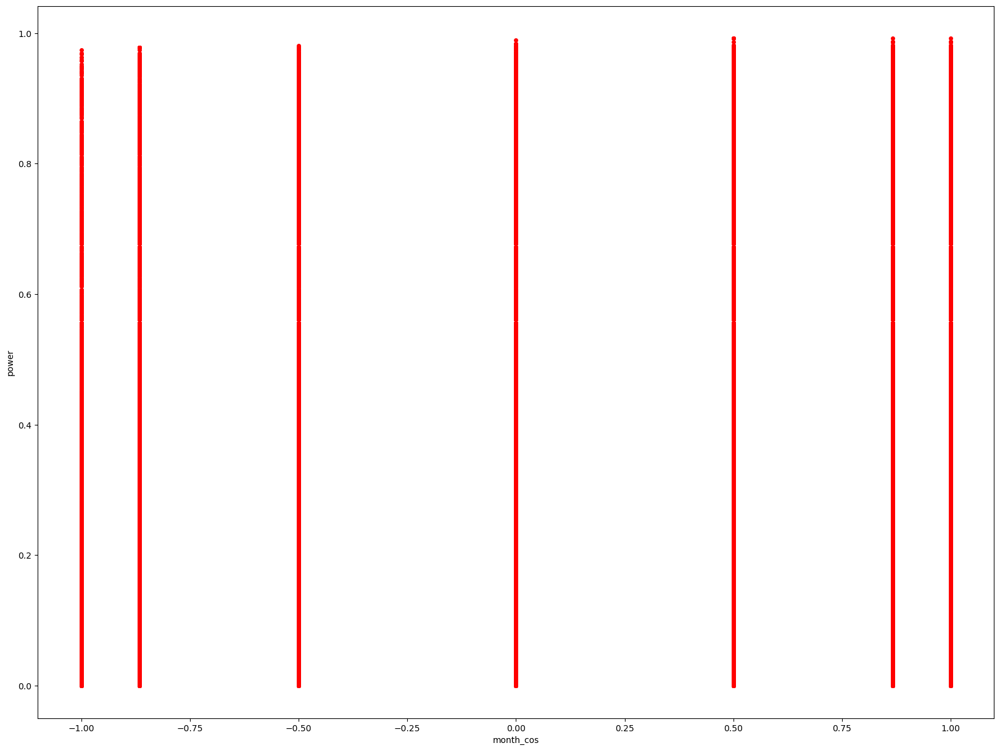

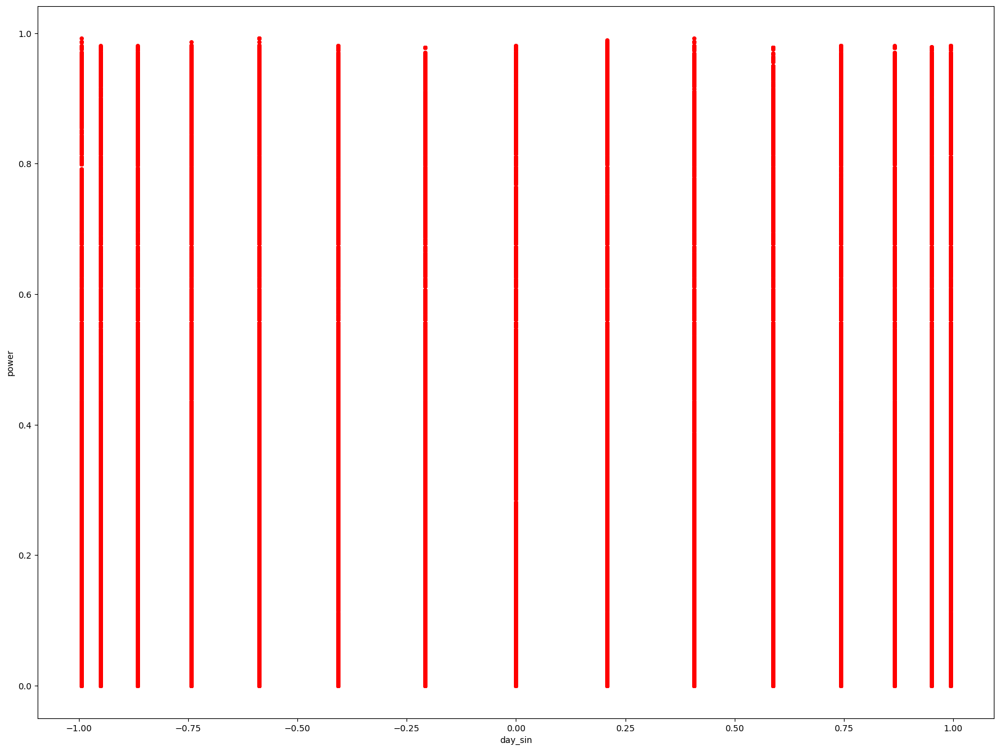

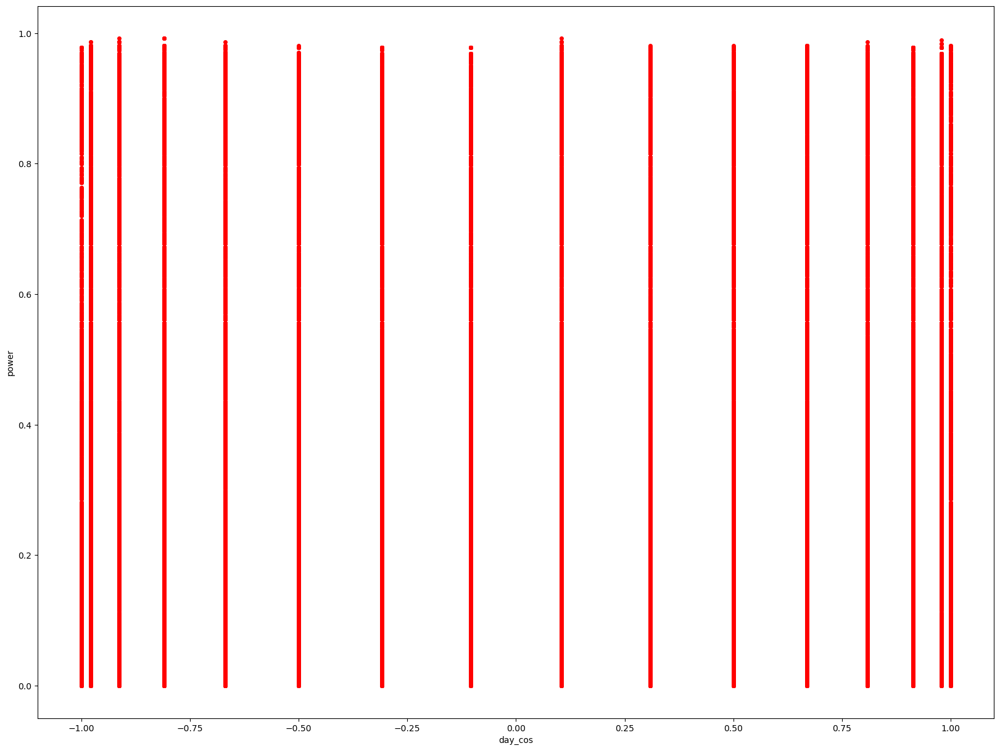

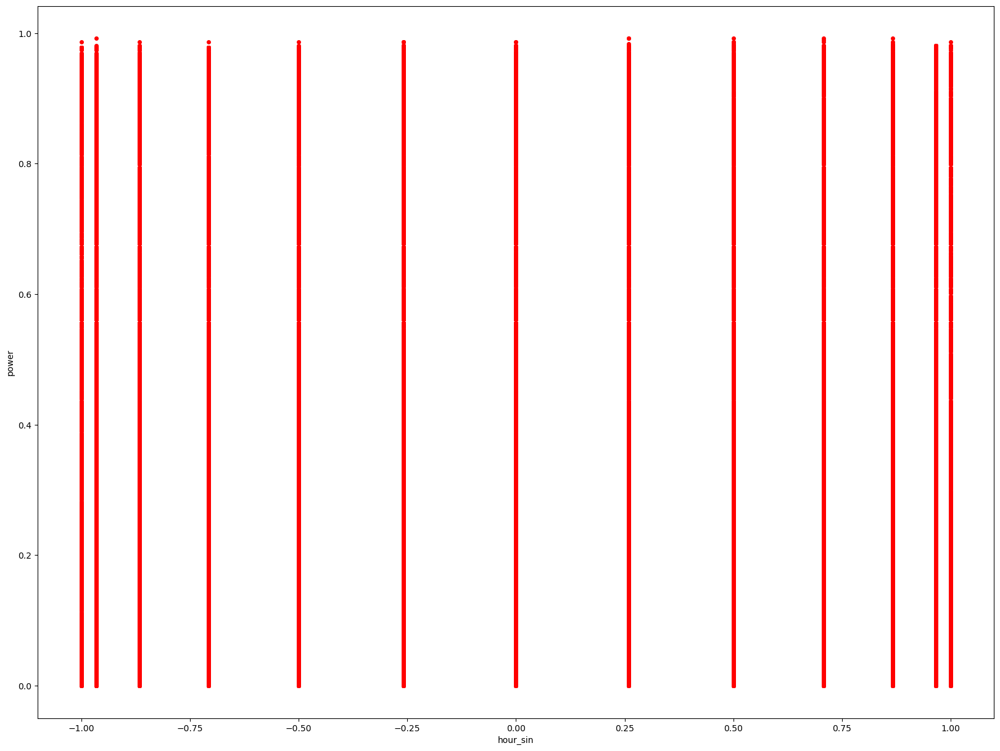

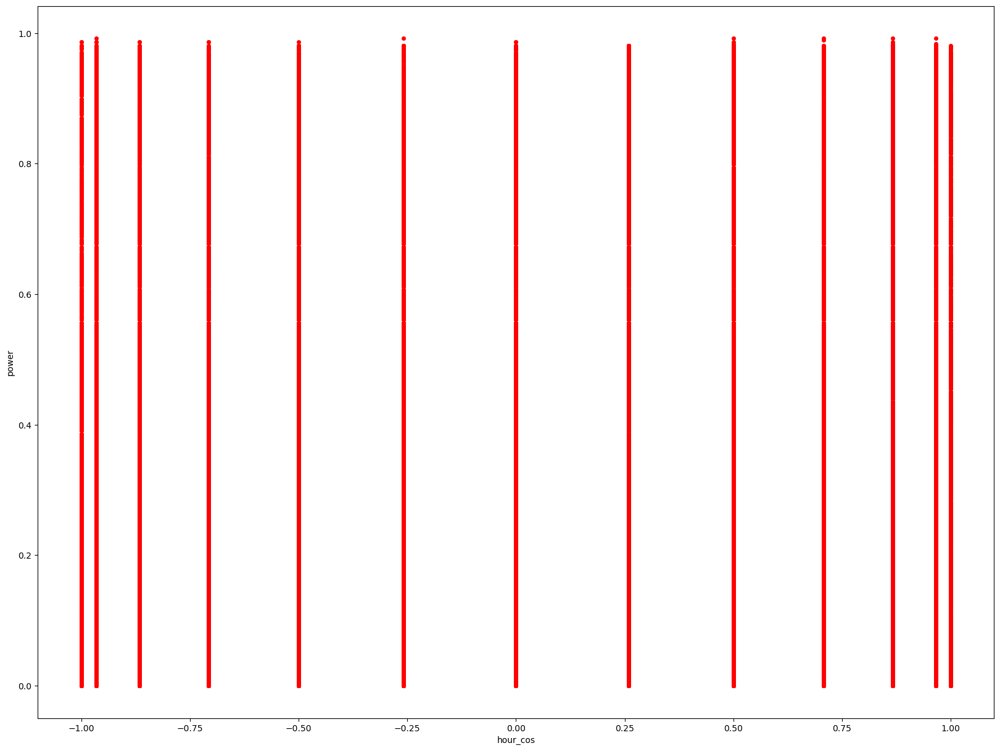

In [ ]:
X_axis_val = ['wind_farm', 'u_avg', 'v_avg', 'ws_avg','wd_avg_sin', 'wd_avg_cos','month_sin', 'month_cos', 'day_sin','day_cos', 'hour_sin', 'hour_cos']
Y_axis_val = ["power"]

plotting_x_vs_y(imp,X_axis_val,Y_axis_val)

<h1 style="color:red;" id="ml_approach"><u><b>ML APPROACH</b></u></h1>
<a class="anchor-link" href="https://www.kaggle.com/code/gmudit/git-my/notebook#ml_approach">¶</a>

In [ ]:
combined.head()

,date,u,v,ws,wd,wind_farm,u_avg,v_avg,ws_avg,wd_avg,...,weekday,wd_avg_sin,wd_avg_cos,month_sin,month_cos,day_sin,day_cos,hour_sin,hour_cos,power
13,2009-07-01 13:00:00,2.77,-0.65,2.85,103.17,wp1,2.770,-0.650,2.850,103.170,...,1.0,0.973698,-0.227841,-0.5,-0.866025,0.207912,0.978148,-0.258819,-0.965926,0.00
14,2009-07-01 14:00:00,3.12,-0.74,3.20,103.36,wp1,2.945,-0.695,3.025,103.265,...,1.0,0.973319,-0.229455,-0.5,-0.866025,0.207912,0.978148,-0.500000,-0.866025,0.01
15,2009-07-01 15:00:00,3.29,-0.62,3.35,100.63,wp1,3.205,-0.680,3.275,101.995,...,1.0,0.978166,-0.207826,-0.5,-0.866025,0.207912,0.978148,-0.707107,-0.707107,0.00
16,2009-07-01 16:00:00,3.31,-0.37,3.33,96.42,wp1,3.300,-0.495,3.340,98.525,...,1.0,0.988951,-0.148241,-0.5,-0.866025,0.207912,0.978148,-0.866025,-0.500000,0.00
17,2009-07-01 17:00:00,3.17,-0.13,3.17,92.38,wp1,3.240,-0.250,3.250,94.400,...,1.0,0.997053,-0.076719,-0.5,-0.866025,0.207912,0.978148,-0.965926,-0.258819,0.00


In [ ]:
combined.to_csv("saving_feature_engineering.csv",index=False)

> **GETTING DATES TO PREDICT ON**


In [ ]:
test_csv = pd.read_csv("/kaggle/input/GEF2012-wind-forecasting/test.csv")
test_df = pd.DataFrame(test_csv)

In [ ]:
test_df.head()

,id,date
0,4866,2011122106
1,2167,2011060719
2,5522,2012020714
3,6474,2012041518
4,3889,2011101113


In [ ]:
date_test = test_df.set_index("date")
date_test.index = date_test.index.sort_values()
date_test["date"] =date_test.index
date_test.set_index("id",inplace=True)
date_test["date"] = pd.to_datetime(date_test["date"],format = "%Y%m%d%H")

In [ ]:
date_test.head()

,date
id,
4866,2011-01-01 01:00:00
2167,2011-01-01 02:00:00
5522,2011-01-01 03:00:00
6474,2011-01-01 04:00:00
3889,2011-01-01 05:00:00


In [ ]:
date_test.date.is_unique

True

In [ ]:
wp1,wp2,wp3,wp4,wp5,wp6,wp7= conv_to_datetime(paths )

In [ ]:


wp1["wind_farm"] = "wp1"
wp2["wind_farm"] = "wp2"
wp3["wind_farm"] = "wp3"
wp4["wind_farm"] = "wp4"
wp5["wind_farm"] = "wp5"
wp6["wind_farm"] = "wp6"
wp7["wind_farm"] = "wp7"



In [ ]:
t1 = pd.merge(date_test,wp1,how="left",left_on="date",right_on="forecast_date")
t2 = pd.merge(date_test,wp2,how="left",left_on="date",right_on="forecast_date")
t3 = pd.merge(date_test,wp3,how="left",left_on="date",right_on="forecast_date")
t4 = pd.merge(date_test,wp4,how="left",left_on="date",right_on="forecast_date")
t5 = pd.merge(date_test,wp5,how="left",left_on="date",right_on="forecast_date")
t6 = pd.merge(date_test,wp6,how="left",left_on="date",right_on="forecast_date")
t7 = pd.merge(date_test,wp7,how="left",left_on="date",right_on="forecast_date")



In [ ]:
features = ["u","v","ws","wd"] 
t1 = rolling_averages(t1,features)
t2 = rolling_averages(t2,features)
t3 = rolling_averages(t3,features)
t4 = rolling_averages(t4,features)
t5 = rolling_averages(t5,features)
t6 = rolling_averages(t6,features)
t7 = rolling_averages(t7,features)

In [ ]:
t1 = indiv_date(t1)
t2 = indiv_date(t2)
t3 = indiv_date(t3)
t4 = indiv_date(t4)
t5 = indiv_date(t5)
t6 = indiv_date(t6)
t7 = indiv_date(t7)

In [ ]:

t1.drop("forecast_date",axis=1,inplace=True)
t2.drop("forecast_date",axis=1,inplace=True)
t3.drop("forecast_date",axis=1,inplace=True)
t4.drop("forecast_date",axis=1,inplace=True)
t5.drop("forecast_date",axis=1,inplace=True)
t6.drop("forecast_date",axis=1,inplace=True)
t7.drop("forecast_date",axis=1,inplace=True)


In [ ]:


col = ["wd_avg","month","day","hour"]
max_val=[360,12,30,24]

cyc_encode(t1,col,max_val)
cyc_encode(t2,col,max_val)
cyc_encode(t3,col,max_val)
cyc_encode(t4,col,max_val)
cyc_encode(t5,col,max_val)
cyc_encode(t6,col,max_val)
cyc_encode(t7,col,max_val)



In [ ]:

saving_test = pd.concat([t1,t2,t3,t4,t5,t6,t7])



In [ ]:
saving_test.to_csv("saveing_processed_tests.csv",index=False)

> **FEW MORE STEPS OF PREPROCESSING AND FEATURE SELECTION USING ABOVE ANALYSIS**

In [ ]:
savedtraindf = combined.drop("date",axis=1)

In [ ]:
test_data = saving_test.drop("date",axis=1)

In [ ]:
savedtraindf.head()

,u,v,ws,wd,wind_farm,u_avg,v_avg,ws_avg,wd_avg,year,...,weekday,wd_avg_sin,wd_avg_cos,month_sin,month_cos,day_sin,day_cos,hour_sin,hour_cos,power
13,2.77,-0.65,2.85,103.17,wp1,2.770,-0.650,2.850,103.170,2009.0,...,1.0,0.973698,-0.227841,-0.5,-0.866025,0.207912,0.978148,-0.258819,-0.965926,0.00
14,3.12,-0.74,3.20,103.36,wp1,2.945,-0.695,3.025,103.265,2009.0,...,1.0,0.973319,-0.229455,-0.5,-0.866025,0.207912,0.978148,-0.500000,-0.866025,0.01
15,3.29,-0.62,3.35,100.63,wp1,3.205,-0.680,3.275,101.995,2009.0,...,1.0,0.978166,-0.207826,-0.5,-0.866025,0.207912,0.978148,-0.707107,-0.707107,0.00
16,3.31,-0.37,3.33,96.42,wp1,3.300,-0.495,3.340,98.525,2009.0,...,1.0,0.988951,-0.148241,-0.5,-0.866025,0.207912,0.978148,-0.866025,-0.500000,0.00
17,3.17,-0.13,3.17,92.38,wp1,3.240,-0.250,3.250,94.400,2009.0,...,1.0,0.997053,-0.076719,-0.5,-0.866025,0.207912,0.978148,-0.965926,-0.258819,0.00


In [ ]:
test_data.head()

,u,v,ws,wd,wind_farm,u_avg,v_avg,ws_avg,wd_avg,year,...,dayofweek,weekday,wd_avg_sin,wd_avg_cos,month_sin,month_cos,day_sin,day_cos,hour_sin,hour_cos
0,3.2200,4.2025,5.2950,37.4525,wp1,3.22000,4.20250,5.29500,37.45250,2011,...,5,0,0.608104,0.793858,0.5,0.866025,0.207912,0.978148,0.258819,0.965926
1,2.9175,3.9150,4.8850,36.6250,wp1,3.06875,4.05875,5.09000,37.03875,2011,...,5,0,0.602355,0.798228,0.5,0.866025,0.207912,0.978148,0.500000,0.866025
2,2.6100,3.7375,4.5650,34.8250,wp1,2.76375,3.82625,4.72500,35.72500,2011,...,5,0,0.583895,0.811829,0.5,0.866025,0.207912,0.978148,0.707107,0.707107
3,2.4325,3.7475,4.4700,32.8725,wp1,2.52125,3.74250,4.51750,33.84875,2011,...,5,0,0.557002,0.830511,0.5,0.866025,0.207912,0.978148,0.866025,0.500000
4,2.3050,3.8725,4.5075,30.6950,wp1,2.36875,3.81000,4.48875,31.78375,2011,...,5,0,0.526715,0.850042,0.5,0.866025,0.207912,0.978148,0.965926,0.258819


In [ ]:
savedtraindf.columns


Index(['u', 'v', 'ws', 'wd', 'wind_farm', 'u_avg', 'v_avg', 'ws_avg', 'wd_avg',
       'year', 'month', 'day', 'hour', 'dayofweek', 'weekday', 'wd_avg_sin',
       'wd_avg_cos', 'month_sin', 'month_cos', 'day_sin', 'day_cos',
       'hour_sin', 'hour_cos', 'power'],
      dtype='object')

In [ ]:
savedtraindf.drop(['u', 'v', 'ws', 'wd','year', 'month', 'day', 'hour', 'dayofweek', 'weekday'],axis=1,inplace=True)
test_data.drop(['u', 'v', 'ws', 'wd','year', 'month', 'day', 'hour', 'dayofweek', 'weekday'],axis=1,inplace=True)
       

In [ ]:
test_data.head()

,wind_farm,u_avg,v_avg,ws_avg,wd_avg,wd_avg_sin,wd_avg_cos,month_sin,month_cos,day_sin,day_cos,hour_sin,hour_cos
0,wp1,3.22000,4.20250,5.29500,37.45250,0.608104,0.793858,0.5,0.866025,0.207912,0.978148,0.258819,0.965926
1,wp1,3.06875,4.05875,5.09000,37.03875,0.602355,0.798228,0.5,0.866025,0.207912,0.978148,0.500000,0.866025
2,wp1,2.76375,3.82625,4.72500,35.72500,0.583895,0.811829,0.5,0.866025,0.207912,0.978148,0.707107,0.707107
3,wp1,2.52125,3.74250,4.51750,33.84875,0.557002,0.830511,0.5,0.866025,0.207912,0.978148,0.866025,0.500000
4,wp1,2.36875,3.81000,4.48875,31.78375,0.526715,0.850042,0.5,0.866025,0.207912,0.978148,0.965926,0.258819


In [ ]:
y = savedtraindf.power
x = savedtraindf.drop("power",axis=1)

In [ ]:
x.reset_index(inplace=True)

In [ ]:
x.shape

(131208, 14)

In [ ]:
def cat_encoding(working_df,categorical_features):
    for feature in categorical_features:
        if working_df[feature].dtype != bool:
            dummy = pd.get_dummies(working_df[feature])
            working_df = pd.merge(left=working_df,right=dummy,left_index=True,right_index=True)
            working_df.drop(feature,axis=1,inplace=True)
            print(working_df.shape)
    return working_df

In [ ]:
categorical_features=["wind_farm"]
x= cat_encoding(x,categorical_features)

(131208, 20)


In [ ]:
x.shape

(131208, 20)

In [ ]:
test_data.reset_index(inplace=True)
test_data.drop("index",axis=1,inplace=True)

xtest = cat_encoding(test_data,categorical_features)

(52416, 19)


In [ ]:
x.head()

,index,u_avg,v_avg,ws_avg,wd_avg,wd_avg_sin,wd_avg_cos,month_sin,month_cos,day_sin,day_cos,hour_sin,hour_cos,wp1,wp2,wp3,wp4,wp5,wp6,wp7
0,13,2.770,-0.650,2.850,103.170,0.973698,-0.227841,-0.5,-0.866025,0.207912,0.978148,-0.258819,-0.965926,1,0,0,0,0,0,0
1,14,2.945,-0.695,3.025,103.265,0.973319,-0.229455,-0.5,-0.866025,0.207912,0.978148,-0.500000,-0.866025,1,0,0,0,0,0,0
2,15,3.205,-0.680,3.275,101.995,0.978166,-0.207826,-0.5,-0.866025,0.207912,0.978148,-0.707107,-0.707107,1,0,0,0,0,0,0
3,16,3.300,-0.495,3.340,98.525,0.988951,-0.148241,-0.5,-0.866025,0.207912,0.978148,-0.866025,-0.500000,1,0,0,0,0,0,0
4,17,3.240,-0.250,3.250,94.400,0.997053,-0.076719,-0.5,-0.866025,0.207912,0.978148,-0.965926,-0.258819,1,0,0,0,0,0,0


In [ ]:
x.drop("index",axis=1,inplace=True)

In [ ]:
xtest.head()

,u_avg,v_avg,ws_avg,wd_avg,wd_avg_sin,wd_avg_cos,month_sin,month_cos,day_sin,day_cos,hour_sin,hour_cos,wp1,wp2,wp3,wp4,wp5,wp6,wp7
0,3.22000,4.20250,5.29500,37.45250,0.608104,0.793858,0.5,0.866025,0.207912,0.978148,0.258819,0.965926,1,0,0,0,0,0,0
1,3.06875,4.05875,5.09000,37.03875,0.602355,0.798228,0.5,0.866025,0.207912,0.978148,0.500000,0.866025,1,0,0,0,0,0,0
2,2.76375,3.82625,4.72500,35.72500,0.583895,0.811829,0.5,0.866025,0.207912,0.978148,0.707107,0.707107,1,0,0,0,0,0,0
3,2.52125,3.74250,4.51750,33.84875,0.557002,0.830511,0.5,0.866025,0.207912,0.978148,0.866025,0.500000,1,0,0,0,0,0,0
4,2.36875,3.81000,4.48875,31.78375,0.526715,0.850042,0.5,0.866025,0.207912,0.978148,0.965926,0.258819,1,0,0,0,0,0,0


> **SPLITTING DATASET AND SCALING**

In [ ]:


from sklearn.model_selection import train_test_split as tts
from sklearn.preprocessing import StandardScaler as SS



In [ ]:


cat_df = x[["wp1","wp2","wp3","wp4","wp5","wp6","wp7"]]
cont_df = x.drop(["wp1","wp2","wp3","wp4","wp5","wp6","wp7"],axis=1)



In [ ]:


cat_test = xtest[["wp1","wp2","wp3","wp4","wp5","wp6","wp7"]]
cont_test = xtest.drop(["wp1","wp2","wp3","wp4","wp5","wp6","wp7"],axis=1)




In [ ]:
scale=SS()

In [ ]:


scaled_ctr = scale.fit_transform(cont_df)
scaled_ctr = pd.DataFrame(scaled_ctr)


scaled_cte = scale.fit_transform(cont_test)
scaled_cte = pd.DataFrame(scaled_cte)




In [ ]:


cat_df.shape,scaled_ctr.shape,scaled_cte.shape,cat_test.shape



((131208, 7), (131208, 12), (52416, 12), (52416, 7))

In [ ]:
total_X = pd.merge(cat_df,scaled_ctr,how="left",left_index=True,right_index=True)
total_test = pd.merge(cat_test,scaled_cte,how="left",left_index=True,right_index=True)

In [ ]:
total_X

,wp1,wp2,wp3,wp4,wp5,wp6,wp7,0,1,2,3,4,5,6,7,8,9,10,11
0,1,0,0,0,0,0,0,0.469175,-0.146412,-0.798077,-0.579924,1.104890,-0.129987,-0.587244,-1.256915,0.289101,1.359002,-3.660254e-01,-1.366025
1,1,0,0,0,0,0,0,0.522110,-0.158765,-0.719221,-0.578864,1.104339,-0.132364,-0.587244,-1.256915,0.289101,1.359002,-7.071068e-01,-1.224745
2,1,0,0,0,0,0,0,0.600755,-0.154648,-0.606569,-0.593029,1.111382,-0.100523,-0.587244,-1.256915,0.289101,1.359002,-1.000000e+00,-1.000000
3,1,0,0,0,0,0,0,0.629491,-0.103862,-0.577279,-0.631731,1.127054,-0.012804,-0.587244,-1.256915,0.289101,1.359002,-1.224745e+00,-0.707107
4,1,0,0,0,0,0,0,0.611342,-0.036606,-0.617834,-0.677739,1.138826,0.092487,-0.587244,-1.256915,0.289101,1.359002,-1.366025e+00,-0.366025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
131203,0,0,0,0,0,0,1,0.021878,-1.125058,-0.088934,0.084554,0.121008,-1.200476,0.125558,-1.446441,-1.063493,0.924342,1.224745e+00,-0.707107
131204,0,0,0,0,0,0,1,-0.044668,-1.216677,0.028223,0.127940,0.025871,-1.226860,0.125558,-1.446441,-1.063493,0.924342,1.000000e+00,-1.000000
131205,0,0,0,0,0,0,1,-0.114239,-1.265061,0.085113,0.167396,-0.062000,-1.245126,0.125558,-1.446441,-1.063493,0.924342,7.071068e-01,-1.224745
131206,0,0,0,0,0,0,1,-0.160746,-1.258198,0.071031,0.191124,-0.115323,-1.253453,0.125558,-1.446441,-1.063493,0.924342,3.660254e-01,-1.366025


In [ ]:

xtrain,xval,ytrain,yval = tts(total_X,y,shuffle=False)


> **USING CATBOOST REGRESSOR**
<br>
<a href="https://catboost.ai/en/docs/concepts/python-reference_catboostregressor">**REFERENCE**

In [ ]:
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV

In [ ]:
cat = CatBoostRegressor()

In [ ]:
cat.fit(xtrain,ytrain)

Learning rate set to 0.084543
0:	learn: 0.2713019	total: 71.6ms	remaining: 1m 11s
1:	learn: 0.2578511	total: 89.7ms	remaining: 44.8s
2:	learn: 0.2458885	total: 105ms	remaining: 34.8s
3:	learn: 0.2353085	total: 122ms	remaining: 30.4s
4:	learn: 0.2258892	total: 141ms	remaining: 28s
5:	learn: 0.2176839	total: 163ms	remaining: 27s
6:	learn: 0.2101996	total: 183ms	remaining: 26s
7:	learn: 0.2035663	total: 203ms	remaining: 25.1s
8:	learn: 0.1977707	total: 219ms	remaining: 24.1s
9:	learn: 0.1927033	total: 230ms	remaining: 22.8s
10:	learn: 0.1883572	total: 241ms	remaining: 21.7s
11:	learn: 0.1844861	total: 253ms	remaining: 20.9s
12:	learn: 0.1810540	total: 266ms	remaining: 20.2s
13:	learn: 0.1779791	total: 278ms	remaining: 19.6s
14:	learn: 0.1752976	total: 289ms	remaining: 19s
15:	learn: 0.1729106	total: 301ms	remaining: 18.5s
16:	learn: 0.1708336	total: 312ms	remaining: 18.1s
17:	learn: 0.1689909	total: 323ms	remaining: 17.6s
18:	learn: 0.1672671	total: 335ms	remaining: 17.3s
19:	learn: 0.165

In [ ]:
ypred = cat.predict(xval)

In [ ]:
import math
import sklearn.metrics
def compute_rmse(yval,ypred):
    mse = sklearn.metrics.mean_squared_error(yval, ypred)
    rmse = math.sqrt(mse)
    print("MSE :",mse)
    print("RMSE :",rmse)

In [ ]:
compute_rmse(yval,ypred)

MSE : 0.03081904238060469
RMSE : 0.17555353138175459


> **HYPERPARAMETER TUNING USING GRIDSEARCHCV**
<br>
<a href="https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html">**REFERENCE**</a>

In [ ]:
mod = CatBoostRegressor(eval_metric='RMSE',
                          random_seed=47)

search_params = {
    'depth': [5,10,20,50],
    'learning_rate': [0.01, 0.05, 0.1],
    'iterations': [10, 50, 100, 300, 500, 1000]
}

fit_params = {
    'early_stopping_rounds': 100,
    'eval_set':[(xval, yval)],
    'verbose': 1,
}

grid_cv = GridSearchCV(estimator=mod, 
                       param_grid=search_params,
                       cv=2,n_jobs=-1)



grid_cv.fit(xtrain,ytrain, **fit_params)


print(" Results from Grid Search " )
print("\n The best estimator across ALL searched params:\n",grid_cv.best_estimator_)
print("\n The best score across ALL searched params:\n",grid_cv.best_score_)
print("\n The best parameters across ALL searched params:\n",grid_cv.best_params_)

0:	learn: 0.2970924	test: 0.2972408	best: 0.2972408 (0)	total: 98ms	remaining: 882ms
1:	learn: 0.2951529	test: 0.2950087	best: 0.2950087 (1)	total: 145ms	remaining: 580ms
2:	learn: 0.2932080	test: 0.2928649	best: 0.2928649 (2)	total: 179ms	remaining: 417ms
3:	learn: 0.2913868	test: 0.2908404	best: 0.2908404 (3)	total: 189ms	remaining: 284ms
4:	learn: 0.2895551	test: 0.2888781	best: 0.2888781 (4)	total: 203ms	remaining: 203ms
5:	learn: 0.2877032	test: 0.2867785	best: 0.2867785 (5)	total: 217ms	remaining: 145ms
6:	learn: 0.2858656	test: 0.2847548	best: 0.2847548 (6)	total: 229ms	remaining: 98.3ms
7:	learn: 0.2840718	test: 0.2827691	best: 0.2827691 (7)	total: 241ms	remaining: 60.2ms
8:	learn: 0.2822721	test: 0.2807436	best: 0.2807436 (8)	total: 253ms	remaining: 28.1ms
9:	learn: 0.2805442	test: 0.2789718	best: 0.2789718 (9)	total: 264ms	remaining: 0us

bestTest = 0.2789717688
bestIteration = 9

0:	learn: 0.2796644	test: 0.2776422	best: 0.2776422 (0)	total: 13.8ms	remaining: 124ms
1:	learn:

> <h2 style ="color:red;"><u><b>RESULT OF GRID SEARCH CV for CatBoostRegressor</b></u></h2>
> <ul style="list-style:square;
             color:green;">
    <li>The best score across ALL searched params:
 <b>0.6701132244411406<b></li>
    <li> The best parameters across ALL searched params:
 <b>{'depth': 10, 'iterations': 50, 'learning_rate': 0.1}<b></li>
</ul>




In [ ]:
tune_cat = CatBoostRegressor(depth= 10, iterations= 50, learning_rate= 0.1,loss_function="RMSE")

In [ ]:
tune_cat.fit(xtrain,ytrain)

0:	learn: 0.2680789	total: 42.2ms	remaining: 42.2s
1:	learn: 0.2520782	total: 82.4ms	remaining: 41.1s
2:	learn: 0.2376969	total: 121ms	remaining: 40.1s
3:	learn: 0.2253734	total: 161ms	remaining: 40.2s
4:	learn: 0.2145955	total: 199ms	remaining: 39.5s
5:	learn: 0.2051548	total: 236ms	remaining: 39.2s
6:	learn: 0.1969977	total: 282ms	remaining: 39.9s
7:	learn: 0.1899897	total: 320ms	remaining: 39.7s
8:	learn: 0.1838306	total: 361ms	remaining: 39.7s
9:	learn: 0.1783415	total: 401ms	remaining: 39.7s
10:	learn: 0.1737473	total: 440ms	remaining: 39.5s
11:	learn: 0.1699879	total: 479ms	remaining: 39.4s
12:	learn: 0.1667179	total: 519ms	remaining: 39.4s
13:	learn: 0.1634723	total: 557ms	remaining: 39.2s
14:	learn: 0.1610678	total: 596ms	remaining: 39.2s
15:	learn: 0.1587409	total: 634ms	remaining: 39s
16:	learn: 0.1568887	total: 672ms	remaining: 38.9s
17:	learn: 0.1551327	total: 710ms	remaining: 38.8s
18:	learn: 0.1534034	total: 749ms	remaining: 38.7s
19:	learn: 0.1522410	total: 787ms	remaini

In [ ]:
ypred_tuned = tune_cat.predict(xval)

In [ ]:
compute_rmse(yval,ypred_tuned)

MSE : 0.02926756715022934
RMSE : 0.17107766408923564


**TRYING LIGHT GRADIENT BOOST MACHINE REGRESSOR**

In [ ]:
from lightgbm import LGBMRegressor


In [ ]:
lgbm =LGBMRegressor()
lgbm.fit(xtrain, ytrain)

LGBMRegressor()

In [ ]:
ypred_lgbm = lgbm.predict(xval)

In [ ]:
compute_rmse(yval,ypred_lgbm)

MSE : 0.032739072513907376
RMSE : 0.1809394166949462


> <div>
    <h1 style="color:red;" id="ml_scores"><u><b>SCORES</b></u></h1>
    <a class="anchor-link" href="https://www.kaggle.com/code/gmudit/git-my/notebook#ml_scores">¶</a>
     <h3><b>NORMAL CATBOOST :</b></h3>
    <ul style="list-style:square;
               color:green;
               font-weight: bold;">
        <li>MSE : 0.03081904238060469</li>
        <li>RMSE : 0.17555353138175459</li>
    </ul>
     <h3><b>TUNED CATBOOST :</b></h3>
    <ul style="list-style:square;
               color:green;
               font-weight: bold;">
        <li>MSE : 0.029267567150229</li>
        <li>RMSE : 0.17107766408923564</li>
    </ul>
     <h3><b>LIGHTGBM :</b></h3>
    <ul style="list-style:square;
               color:green;
               font-weight: bold;">
        <li>MSE : 0.032739072513907376</li>
        <li>RMSE : 0.1809394166949462</li>
    </ul>
</div>

**CONCLUSION: TUNED CATBOOST IS BETTER TO USE**

In [ ]:
predictions = tune_cat.predict(total_test)

In [ ]:
power_vals = pd.DataFrame()
power_vals["power"] = predictions
power_vals

,power
0,0.524630
1,0.446812
2,0.416419
3,0.425717
4,0.417206
...,...
52411,0.323158
52412,0.331213
52413,0.303780
52414,0.289955


In [ ]:
s = len(power_vals)/7
s = int(s)

power1 = power_vals[:1*s]
power2 = power_vals[s:2*s]
power3 = power_vals[2*s:3*s]
power4 = power_vals[3*s:4*s]
power5 = power_vals[4*s:5*s]
power6 = power_vals[5*s:6*s]
power7 = power_vals[6*s:7*s]

In [ ]:
power1["wp1"] = power1.power
power2["wp2"] = power2.power
power3["wp3"] = power3.power
power4["wp4"] = power4.power
power5["wp5"] = power5.power
power6["wp6"] = power6.power
power7["wp7"] = power7.power

In [ ]:


power1.drop("power",axis=1,inplace=True)
power2.drop("power",axis=1,inplace=True)
power3.drop("power",axis=1,inplace=True)
power4.drop("power",axis=1,inplace=True)
power5.drop("power",axis=1,inplace=True)
power6.drop("power",axis=1,inplace=True)
power7.drop("power",axis=1,inplace=True)



In [ ]:
power2.reset_index(inplace=True)
power3.reset_index(inplace=True)
power4.reset_index(inplace=True)
power5.reset_index(inplace=True)
power6.reset_index(inplace=True)
power7.reset_index(inplace=True)

power2.drop("index",axis=1,inplace=True)
power3.drop("index",axis=1,inplace=True)
power4.drop("index",axis=1,inplace=True)
power5.drop("index",axis=1,inplace=True)
power6.drop("index",axis=1,inplace=True)
power7.drop("index",axis=1,inplace=True)

In [ ]:

power3


,wp3
0,0.698577
1,0.655841
2,0.712602
3,0.699641
4,0.699915
...,...
7483,0.238140
7484,0.263491
7485,0.242826
7486,0.218197


In [ ]:


datetest_in = date_test.reset_index()



In [ ]:


mer1 = pd.merge(datetest_in,power1,how="left",left_index=True,right_index=True)
mer2 =pd.merge(mer1,power2,how="left",left_index=True,right_index=True)
mer3 =pd.merge(mer2,power3,how="left",left_index=True,right_index=True)
mer4 =pd.merge(mer3,power4,how="left",left_index=True,right_index=True)
mer5 =pd.merge(mer4,power5,how="left",left_index=True,right_index=True)
mer6 =pd.merge(mer5,power6,how="left",left_index=True,right_index=True)
mer7 =pd.merge(mer6,power7,how="left",left_index=True,right_index=True)



In [ ]:
mer7["date"] = mer7.date.dt.strftime("%Y%m%d%H")

In [ ]:
mer7["date"] = mer7["date"].astype(np.int64)

In [ ]:
mer7

,id,date,wp1,wp2,wp3,wp4,wp5,wp6,wp7
0,4866,2011010101,0.524630,0.077325,0.698577,0.588884,0.460156,0.404131,0.735254
1,2167,2011010102,0.446812,0.082432,0.655841,0.580865,0.437460,0.403475,0.740283
2,5522,2011010103,0.416419,0.046493,0.712602,0.534203,0.464874,0.415002,0.762918
3,6474,2011010104,0.425717,0.161114,0.699641,0.584711,0.443305,0.447642,0.805233
4,3889,2011010105,0.417206,0.580054,0.699915,0.625167,0.399276,0.493852,0.842536
...,...,...,...,...,...,...,...,...,...
7483,2088,2012062808,0.154146,0.333470,0.238140,0.135036,0.048224,0.152685,0.323158
7484,917,2012062809,0.199491,0.334636,0.263491,0.149263,0.064369,0.182363,0.331213
7485,7219,2012062810,0.170261,0.315976,0.242826,0.161876,0.081759,0.170915,0.303780
7486,1846,2012062811,0.123320,0.366438,0.218197,0.151191,0.069493,0.136110,0.289955


In [ ]:
test_df

,id,date
0,4866,2011122106
1,2167,2011060719
2,5522,2012020714
3,6474,2012041518
4,3889,2011101113
...,...,...
7483,2088,2011060112
7484,917,2011030817
7485,7219,2012060919
7486,1846,2011051422


<div class="alert alert-block alert-info"> 📌ONE CAN SEE HERE THAT I MADE A MISTAKE SOMEWHERE WITH ID'S:
    <br>
       <b>CORRECTING IT<b></div>

In [ ]:
mer7.drop(["id"],axis=1,inplace=True)

In [ ]:
now_act = pd.merge(test_df,mer7,how="left",on="date") 
now_act.isnull().sum()

id      0
date    0
wp1     0
wp2     0
wp3     0
wp4     0
wp5     0
wp6     0
wp7     0
dtype: int64

In [ ]:
now_act

,id,date,wp1,wp2,wp3,wp4,wp5,wp6,wp7
0,4866,2011122106,0.176891,0.280368,0.121568,0.302043,0.296764,0.360859,0.778924
1,2167,2011060719,0.017310,0.057058,0.132358,0.030347,0.039309,0.045845,0.029048
2,5522,2012020714,0.164894,0.144053,0.035828,0.179707,0.135632,0.235335,0.508873
3,6474,2012041518,0.385330,0.218954,0.787007,0.245948,0.273387,0.448890,0.685453
4,3889,2011101113,0.196478,0.209636,0.056293,0.202661,0.105615,0.138272,0.219334
...,...,...,...,...,...,...,...,...,...
7483,2088,2011060112,0.393018,0.394899,0.281652,0.690097,0.351435,0.439197,0.584728
7484,917,2011030817,0.133962,0.631213,0.741903,0.110967,0.107964,0.140613,0.167209
7485,7219,2012060919,0.209219,0.023652,0.296009,0.095142,0.045469,0.102757,0.047469
7486,1846,2011051422,0.475352,0.319410,0.061875,0.644900,0.127011,0.648715,0.800532


In [ ]:
bench_csv=pd.read_csv("/kaggle/input/GEF2012-wind-forecasting/benchmark.csv")
bench_df = pd.DataFrame(bench_csv)

In [ ]:
bench_df

,id,date,wp1,wp2,wp3,wp4,wp5,wp6,wp7
0,1,2011010101,0.551,0.000,0.968,0.645,0.900,0.921,0.833
1,2,2011010102,0.551,0.000,0.968,0.645,0.900,0.921,0.833
2,3,2011010103,0.551,0.000,0.968,0.645,0.900,0.921,0.833
3,4,2011010104,0.551,0.000,0.968,0.645,0.900,0.921,0.833
4,5,2011010105,0.551,0.000,0.968,0.645,0.900,0.921,0.833
...,...,...,...,...,...,...,...,...,...
7483,7484,2012062808,0.226,0.069,0.227,0.011,0.329,0.079,0.000
7484,7485,2012062809,0.226,0.069,0.227,0.011,0.329,0.079,0.000
7485,7486,2012062810,0.226,0.069,0.227,0.011,0.329,0.079,0.000
7486,7487,2012062811,0.226,0.069,0.227,0.011,0.329,0.079,0.000


**OUR now_act DATAFRAME LOOKS A LOT LIKE BENCHMARK FILE**

In [ ]:
now_act.to_csv("Submission_wind_forecast.csv",index=False)

<h1 style="color:red;" id="tsa"><u><b>TIME SERIES ANALYSIS</b></u></h1>
<a class="anchor-link" href="https://www.kaggle.com/code/gmudit/git-my/notebook#tsa">¶</a>

In [ ]:
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller

In [ ]:
df

,date,wp1,wp2,wp3,wp4,wp5,wp6,wp7
0,2009-07-01 00:00:00,0.045,0.233,0.494,0.105,0.056,0.118,0.051
1,2009-07-01 01:00:00,0.085,0.249,0.257,0.105,0.066,0.066,0.051
2,2009-07-01 02:00:00,0.020,0.175,0.178,0.033,0.015,0.026,0.000
3,2009-07-01 03:00:00,0.060,0.085,0.109,0.022,0.010,0.013,0.000
4,2009-07-01 04:00:00,0.045,0.032,0.079,0.039,0.010,0.000,0.000
...,...,...,...,...,...,...,...,...
18752,2012-06-26 08:00:00,0.170,0.138,0.119,0.149,0.339,0.132,0.101
18753,2012-06-26 09:00:00,0.211,0.106,0.208,0.193,0.359,0.132,0.076
18754,2012-06-26 10:00:00,0.251,0.090,0.247,0.132,0.329,0.132,0.076
18755,2012-06-26 11:00:00,0.301,0.058,0.356,0.061,0.293,0.105,0.076


In [ ]:
w1 = pd.DataFrame()
w2 = pd.DataFrame()
w3 = pd.DataFrame()
w4 = pd.DataFrame()
w5 = pd.DataFrame()
w6 = pd.DataFrame()
w7 = pd.DataFrame()
m = [w1,w2,w3,w4,w5,w6,w7]
for i in range(len(m)):
    m[i]["date"] = df.date
    m[i][f"wp{i+1}"] = df[f"wp{i+1}"]
    m[i].set_index("date",inplace=True)

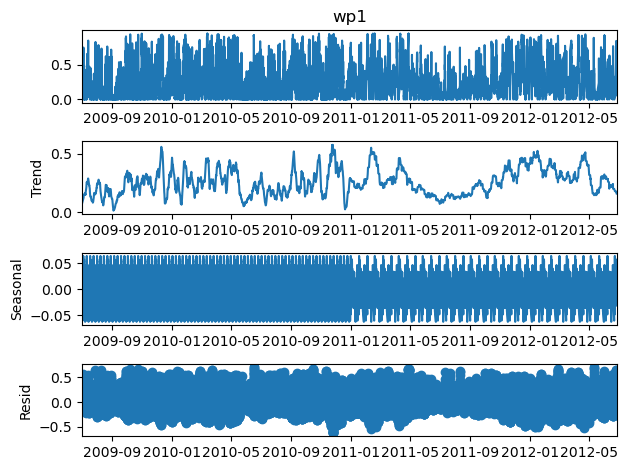

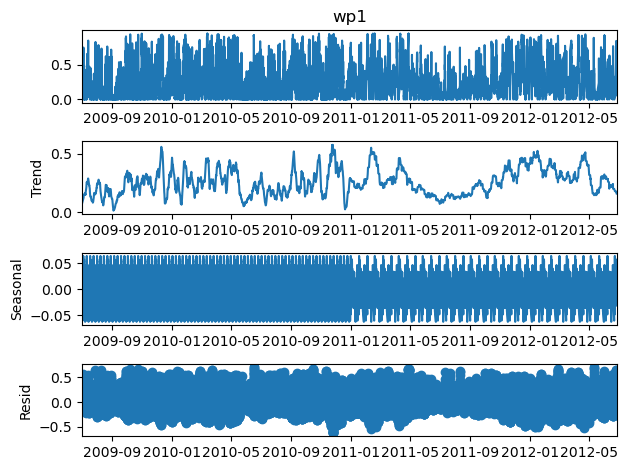

In [ ]:
result = seasonal_decompose(w1.wp1,extrapolate_trend='freq',period = 24*7)
result.plot()


> **ADF TEST**
<br>
<a href = "https://en.wikipedia.org/wiki/Augmented_Dickey%E2%80%93Fuller_test">**REFERNCE**</a>

In [ ]:

def ad_test(dataset):
     dftest = adfuller(dataset, autolag = 'AIC')
     print("1. ADF : ",dftest[0])
     print("2. P-Value : ", dftest[1])
     print("3. Num Of Lags : ", dftest[2])
     print("4. Num Of Observations Used For ADF Regression:",      dftest[3])
     print("5. Critical Values :")
     for key, val in dftest[4].items():
         print("\t",key, ": ", val)





In [ ]:
j=1
for i in m:
    print(f"ADF TEST FOR wp{j}")
    ad_test(i)
    print("\n")
    j+=1

ADF TEST FOR wp1
1. ADF :  -16.327340939235057
2. P-Value :  3.085235287247116e-29
3. Num Of Lags :  33
4. Num Of Observations Used For ADF Regression: 18723
5. Critical Values :
	 1% :  -3.430699313505899
	 5% :  -2.8616943837127167
	 10% :  -2.5668521743326056


ADF TEST FOR wp2
1. ADF :  -19.33821683159472
2. P-Value :  0.0
3. Num Of Lags :  21
4. Num Of Observations Used For ADF Regression: 18735
5. Critical Values :
	 1% :  -3.430699089735597
	 5% :  -2.861694284820294
	 10% :  -2.5668521216937967


ADF TEST FOR wp3
1. ADF :  -18.141567081637984
2. P-Value :  2.490007004593389e-30
3. Num Of Lags :  23
4. Num Of Observations Used For ADF Regression: 18733
5. Critical Values :
	 1% :  -3.430699127010736
	 5% :  -2.861694301293565
	 10% :  -2.5668521304622476


ADF TEST FOR wp4
1. ADF :  -14.203875936632734
2. P-Value :  1.7685884798277317e-26
3. Num Of Lags :  43
4. Num Of Observations Used For ADF Regression: 18713
5. Critical Values :
	 1% :  -3.430699500200411
	 5% :  -2.86169446


> **CONCLUSION:**
<br>
<p><b>Since all p values are almos 0 hence we can say that there is no seasonality</b></p>

In [ ]:
pip install pmdarima


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 18.5 MB/s eta 0:00:0000:010:01
Note: you may need to restart the kernel to use updated packages.


> **USING AUTO ARIMA TO GET p, d and q values**
<br>
[**REFERNCE**](https://alkaline-ml.com/pmdarima/modules/generated/pmdarima.arima.auto_arima.html)

In [ ]:
from pmdarima import auto_arima


In [ ]:
#  2009/7/1 and 2010/12/31

In [ ]:
stepwise_fit = auto_arima(w1.wp1, trace=True,
suppress_warnings=True)

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-42780.635, Time=70.93 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-41967.402, Time=5.70 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-42615.210, Time=3.73 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-42669.453, Time=10.04 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-41969.402, Time=1.12 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=107.09 sec
254:	learn: 0.1427406	test: 0.1791793	best: 0.1778134 (191)	total: 32.7s	remaining: 1m 35s
255:	learn: 0.1426547	test: 0.1792066	best: 0.1778134 (191)	total: 32.9s	remaining: 1m 35s
256:	learn: 0.1425591	test: 0.1792142	best: 0.1778134 (191)	total: 33s	remaining: 1m 35s
257:	learn: 0.1424848	test: 0.1792602	best: 0.1778134 (191)	total: 33.1s	remaining: 1m 35s
258:	learn: 0.1424045	test: 0.1792910	best: 0.1778134 (191)	total: 33.3s	remaining: 1m 35s
259:	learn: 0.1423239	test: 0.1793298	best: 0.1778134 (191)	total: 33.5s	remaining: 1m 35s
260:	lea

In [ ]:
stepwise_fit.summary() 

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                18757
Model:               SARIMAX(3, 1, 1)   Log Likelihood               21619.639
Date:                Fri, 07 Jul 2023   AIC                         -43227.278
Time:                        17:19:23   BIC                         -43180.243
Sample:                             0   HQIC                        -43211.842
                              - 18757                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept  -2.122e-05   1.61e-05     -1.322      0.186   -5.27e-05    1.02e-05
ar.L1          1.1432      0.006    202.032      0.000       1.132       1.154
ar.L2         -0.2245      0.008    -29.225      0.000      -0.240      -0.209
ar.L3          0.0019      0.006      0.321      0.748      -0.010       0.014
ma.L1         -0.9767      0.003   -288.584      0.000      -0.983      -0.970
sigma2         0.0060   2.91e-05    207.042      0.000       0.006       0.006
===================================================================================
Ljung-Box (L1) (Q):                   0.06   Jarque-Bera (JB):            126789.80
Prob(Q):                              0.80   Prob(JB):                         0.00
Heteroskedasticity (H):               1.85   Skew:                             0.26
Prob(H) (two-sided):                  0.00   Kurtosis:                        15.73
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

> **USING ARIMA MODEL**
<br>
[**REFERENCE**](https://www.statsmodels.org/stable/generated/statsmodels.tsa.arima.model.ARIMA.html)

In [ ]:
from statsmodels.tsa.arima.model import ARIMA 

In [ ]:
train_1 = w1["2009-07-01 01:00:00":"2010-08-30 00:00:00"]
val_1 = w1["2010-08-30 01:00:00":"2010-12-31 00:00:00"]
train_1.shape,val_1.shape

train_2 = w2["2009-07-01 01:00:00":"2010-08-30 00:00:00"]
val_2 = w2["2010-08-30 01:00:00":"2010-12-31 00:00:00"]
train_2.shape,val_2.shape

train_3 = w3["2009-07-01 01:00:00":"2010-08-30 00:00:00"]
val_3 = w3["2010-08-30 01:00:00":"2010-12-31 00:00:00"]
train_3.shape,val_3.shape

train_4 = w4["2009-07-01 01:00:00":"2010-08-30 00:00:00"]
val_4 = w4["2010-08-30 01:00:00":"2010-12-31 00:00:00"]
train_4.shape,val_4.shape

train_5 = w5["2009-07-01 01:00:00":"2010-08-30 00:00:00"]
val_5 = w5["2010-08-30 01:00:00":"2010-12-31 00:00:00"]
train_5.shape,val_5.shape

train_6 = w6["2009-07-01 01:00:00":"2010-08-30 00:00:00"]
val_6 = w6["2010-08-30 01:00:00":"2010-12-31 00:00:00"]
train_6.shape,val_6.shape

train_7 = w7["2009-07-01 01:00:00":"2010-08-30 00:00:00"]
val_7 = w7["2010-08-30 01:00:00":"2010-12-31 00:00:00"]
train_7.shape,val_7.shape

((10200, 1), (2952, 1))

In [ ]:
model1 = ARIMA(train_1,order = (2,1,1))
results1 = model1.fit()
print(results1.summary())
print()
print(results1.params)
print()
pred1 = results1.predict(start ="2010-08-30 01:00:00",end = "2010-12-31 00:00:00")
compute_rmse(val_1,pred1)

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                    wp1   No. Observations:                10200
Model:                 ARIMA(2, 1, 1)   Log Likelihood               12886.572
Date:                Fri, 07 Jul 2023   AIC                         -25765.144
Time:                        17:19:30   BIC                         -25736.223
Sample:                    07-01-2009   HQIC                        -25755.364
                         - 08-30-2010                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.2035      0.006    206.819      0.000       1.192       1.215
ar.L2         -0.2695      0.006    -47.861      0.000      -0.281      -0.258
ma.L1         -0.9984      0.001  -1494.746      0.0

In [ ]:
model1_net = ARIMA(w1,order = (2,1,1))
results1_net = model1.fit()
prediction_power_1 = results1_net.predict(start = "2010-12-31 01:00:00",end="2012-06-26 12:00:00",freqs="H")
f1 = pd.DataFrame(prediction_power_1)
f1.shape

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


(13044, 1)

In [ ]:
model2 = ARIMA(train_2,order = (2,1,1))
results2 = model2.fit()
print(results2.summary())
print()
print(results2.params)
print()
pred2 = results2.predict(start ="2010-08-30 01:00:00",end = "2010-12-31 00:00:00")
compute_rmse(val_2,pred2)

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                    wp2   No. Observations:                10200
Model:                 ARIMA(2, 1, 1)   Log Likelihood               13055.913
Date:                Fri, 07 Jul 2023   AIC                         -26103.827
Time:                        17:19:45   BIC                         -26074.907
Sample:                    07-01-2009   HQIC                        -26094.047
                         - 08-30-2010                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.2885      0.006    207.035      0.000       1.276       1.301
ar.L2         -0.3454      0.006    -59.768      0.000      -0.357      -0.334
ma.L1         -0.9985      0.001  -1707.359      0.0

In [ ]:
model2_net = ARIMA(w2,order = (2,1,1))
results2_net = model2.fit()
prediction_power_2 = results2_net.predict(start = "2010-12-31 01:00:00",end="2012-06-26 12:00:00",freqs="H")
f2 = pd.DataFrame(prediction_power_2)
f2.shape

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


(13044, 1)

In [ ]:
model3 = ARIMA(train_3,order = (2,1,1))
results3 = model3.fit()
print(results3.summary())
print()
print(results3.params)
print()
pred3 = results3.predict(start ="2010-08-30 01:00:00",end = "2010-12-31 00:00:00")
compute_rmse(val_3,pred3)

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                    wp3   No. Observations:                10200
Model:                 ARIMA(2, 1, 1)   Log Likelihood                9879.293
Date:                Fri, 07 Jul 2023   AIC                         -19750.587
Time:                        17:19:59   BIC                         -19721.667
Sample:                    07-01-2009   HQIC                        -19740.807
                         - 08-30-2010                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.1299      0.007    173.039      0.000       1.117       1.143
ar.L2         -0.1942      0.006    -33.249      0.000      -0.206      -0.183
ma.L1         -0.9979      0.001  -1484.574      0.0

In [ ]:
model3_net = ARIMA(w3,order = (2,1,1))
results3_net = model3.fit()
prediction_power_3 = results3_net.predict(start = "2010-12-31 01:00:00",end="2012-06-26 12:00:00",freqs="H")
f3 = pd.DataFrame(prediction_power_3)
f3.shape

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


(13044, 1)

In [ ]:
model4 = ARIMA(train_4,order = (2,1,1))
results4 = model4.fit()
print(results4.summary())
print()
print(results4.params)
print()
pred4 = results4.predict(start ="2010-08-30 01:00:00",end = "2010-12-31 00:00:00")
compute_rmse(val_4,pred4)

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                    wp4   No. Observations:                10200
Model:                 ARIMA(2, 1, 1)   Log Likelihood               11198.052
Date:                Fri, 07 Jul 2023   AIC                         -22388.104
Time:                        17:20:07   BIC                         -22359.184
Sample:                    07-01-2009   HQIC                        -22378.324
                         - 08-30-2010                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1898      0.064      2.987      0.003       0.065       0.314
ar.L2         -0.1075      0.017     -6.308      0.000      -0.141      -0.074
ma.L1          0.0664      0.064      1.034      0.3

In [ ]:
model4_net = ARIMA(w4,order = (2,1,1))
results4_net = model4.fit()
prediction_power_4 = results4_net.predict(start = "2010-12-31 01:00:00",end="2012-06-26 12:00:00",freqs="H")
f4 = pd.DataFrame(prediction_power_4)
f4.shape

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


(13044, 1)

In [ ]:
model5 = ARIMA(train_5,order = (2,1,1))
results5 = model5.fit()
print(results5.summary())
print()
print(results5.params)
print()
pred5 = results5.predict(start ="2010-08-30 01:00:00",end = "2010-12-31 00:00:00")
compute_rmse(val_5,pred5)

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                    wp5   No. Observations:                10200
Model:                 ARIMA(2, 1, 1)   Log Likelihood               10776.065
Date:                Fri, 07 Jul 2023   AIC                         -21544.130
Time:                        17:20:19   BIC                         -21515.210
Sample:                    07-01-2009   HQIC                        -21534.351
                         - 08-30-2010                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.1817      0.006    203.753      0.000       1.170       1.193
ar.L2         -0.2531      0.005    -46.369      0.000      -0.264      -0.242
ma.L1         -0.9981      0.001  -1542.383      0.0

In [ ]:
model5_net = ARIMA(w5,order = (2,1,1))
results5_net = model5.fit()
prediction_power_5 = results5_net.predict(start = "2010-12-31 01:00:00",end="2012-06-26 12:00:00",freqs="H")
f5 = pd.DataFrame(prediction_power_5)
f5.shape

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


(13044, 1)

In [ ]:
model6 = ARIMA(train_6,order = (2,1,1))
results6 = model6.fit()
print(results6.summary())
print()
print(results6.params)
print()
pred6 = results6.predict(start ="2010-08-30 01:00:00",end = "2010-12-31 00:00:00")
compute_rmse(val_6,pred6)

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                    wp6   No. Observations:                10200
Model:                 ARIMA(2, 1, 1)   Log Likelihood               11636.672
Date:                Fri, 07 Jul 2023   AIC                         -23265.344
Time:                        17:20:35   BIC                         -23236.424
Sample:                    07-01-2009   HQIC                        -23255.565
                         - 08-30-2010                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.1456      0.006    180.068      0.000       1.133       1.158
ar.L2         -0.2141      0.006    -35.786      0.000      -0.226      -0.202
ma.L1         -0.9981      0.001  -1454.697      0.0

In [ ]:
model6_net = ARIMA(w6,order = (2,1,1))
results6_net = model6.fit()
prediction_power_6 = results6_net.predict(start = "2010-12-31 01:00:00",end="2012-06-26 12:00:00",freqs="H")
f6 = pd.DataFrame(prediction_power_6)
f6.shape

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


(13044, 1)

In [ ]:
model7 = ARIMA(train_7,order = (2,1,1))
results7 = model7.fit()
print(results7.summary())
print()
print(results7.params)
print()
pred7 = results7.predict(start ="2010-08-30 01:00:00",end = "2010-12-31 00:00:00")
compute_rmse(val_7,pred7)

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                    wp7   No. Observations:                10200
Model:                 ARIMA(2, 1, 1)   Log Likelihood               10550.343
Date:                Fri, 07 Jul 2023   AIC                         -21092.687
Time:                        17:20:46   BIC                         -21063.767
Sample:                    07-01-2009   HQIC                        -21082.907
                         - 08-30-2010                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5967      0.048     12.449      0.000       0.503       0.691
ar.L2         -0.2000      0.010    -20.130      0.000      -0.220      -0.181
ma.L1         -0.3871      0.049     -7.868      0.0

In [ ]:
model7_net = ARIMA(w7,order = (2,1,1))
results7_net = model7.fit()
prediction_power_7 = results7_net.predict(start = "2010-12-31 01:00:00",end="2012-06-26 12:00:00",freqs="H")
f7 = pd.DataFrame(prediction_power_7)
f7.shape

/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/opt/conda/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


(13044, 1)

In [ ]:
f1["wp1"] = f1.predicted_mean
f2["wp2"] = f2.predicted_mean
f3["wp3"] = f3.predicted_mean
f4["wp4"] = f4.predicted_mean
f5["wp5"] = f5.predicted_mean
f6["wp6"] = f6.predicted_mean
f7["wp7"] = f7.predicted_mean


In [ ]:
f1.drop("predicted_mean",axis=1,inplace=True)
f2.drop("predicted_mean",axis=1,inplace=True)
f3.drop("predicted_mean",axis=1,inplace=True)
f4.drop("predicted_mean",axis=1,inplace=True)
f5.drop("predicted_mean",axis=1,inplace=True)
f6.drop("predicted_mean",axis=1,inplace=True)
f7.drop("predicted_mean",axis=1,inplace=True)

In [ ]:
net_preds = pd.concat([f1,f2,f3,f4,f5,f6,f7],axis=1)

In [ ]:
net_preds["date"] = net_preds.index

In [ ]:
net_preds["date"] = net_preds.date.dt.strftime("%Y%m%d%H")


In [ ]:
net_preds.reset_index(drop=True,inplace=True)

> <p>I got a little problem here I don't know why date in test_df was in in its original form but in datetime64 dtype so I had to do this 😓😓</p> 

In [ ]:
test_df["date"] = pd.to_datetime(test_df["date"],format="%Y%m%d%H")

In [ ]:
test_df["date"] = test_df.date.dt.strftime("%Y%m%d%H")


In [ ]:
test_df

,id,date
0,4866,2011122106
1,2167,2011060719
2,5522,2012020714
3,6474,2012041518
4,3889,2011101113
...,...,...
7483,2088,2011060112
7484,917,2011030817
7485,7219,2012060919
7486,1846,2011051422


In [ ]:
net_preds_1 = pd.merge(test_df,net_preds,how = "left",on="date")

In [ ]:
net_preds_1.head()

,id,date,wp1,wp2,wp3,wp4,wp5,wp6,wp7
0,4866,2011122106,0.170331,0.210344,0.144155,-2.394461e-07,0.195564,0.171456,0.000031
1,2167,2011060719,0.170331,0.210344,0.144155,-2.394461e-07,0.195564,0.171456,0.000031
2,5522,2012020714,0.170331,0.210344,0.144155,-2.394461e-07,0.195564,0.171456,0.000031
3,6474,2012041518,0.170331,0.210344,0.144155,-2.394461e-07,0.195564,0.171456,0.000031
4,3889,2011101113,0.170331,0.210344,0.144155,-2.394461e-07,0.195564,0.171456,0.000031


<h1 style="color:red;" id="mean_avg"><u><b>TAKING AVERAGE OF ML RESULT(USING CATBOOST) AND TIME SERIES RESULT(USING ARIMA)</b></u></h1>
<a class="anchor-link" href="https://www.kaggle.com/code/gmudit/git-my/notebook#mean_avg">¶</a>

In [ ]:
d = pd.read_csv("/kaggle/input/abcdefgh/Submission_wind_forecast(1).csv")
d = pd.DataFrame(d)

In [ ]:
final = pd.DataFrame(net_preds_1)

In [ ]:
final["wp1"] = (d.wp1 + net_preds_1.wp1)/2
final["wp2"] = (d.wp2 + net_preds_1.wp2)/2
final["wp3"] = (d.wp3 + net_preds_1.wp3)/2
final["wp4"] = (d.wp4 + net_preds_1.wp4)/2
final["wp5"] = (d.wp5 + net_preds_1.wp5)/2
final["wp6"] = (d.wp6 + net_preds_1.wp6)/2
final["wp7"] = (d.wp7 + net_preds_1.wp7)/2

In [ ]:
final.to_csv("FINAL_submission.csv",index=False)

# 